Exploratory Data Analysis on 3 Datasets:

1.   go_emotions_Reddit dataset.csv
2.   Sentiment Analysis for Mental Health_reddit.csv
3.   mental_health_diagnosis_treatment_.csv

First of all, import and download all necessary packages and libraries.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud, STOPWORDS
from nltk.sentiment import SentimentIntensityAnalyzer
import nltk
import re
import warnings

# Initialize
nltk.download('punkt')
nltk.download('vader_lexicon')
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = (12, 8)
warnings.filterwarnings('ignore')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


In [22]:
# Text cleaning
def clean_text(text):
    if not isinstance(text, str):
        return ""
    text = text.lower()
    text = re.sub(r'http\S+|www\S+|https\S+', '', text, flags=re.MULTILINE)
    text = re.sub(r'[^\w\s]', '', text)
    text = re.sub(r'\s+', ' ', text).strip()
    return text

# Word cloud generator
def generate_wordcloud(text, title, colormap='viridis'):
    wc = WordCloud(width=1200, height=600,
                  background_color='white',
                  stopwords=set(STOPWORDS),
                  max_words=200,
                  colormap=colormap,
                  contour_width=1).generate(text)
    plt.figure(figsize=(15, 8))
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.title(f'Characteristic Words: {title}', pad=20, fontsize=16)
    plt.tight_layout()
    plt.show()

(1) EDA on go_emotions_Reddit dataset.csv covers the following:
- Word clouds for all 28 emotions
- Distribution analysis
- Sentiment breakdown
- Comprehensive visualizations

1. Emotion Distribution

Loading GoEmotions dataset...

=== EMOTION DISTRIBUTION ===


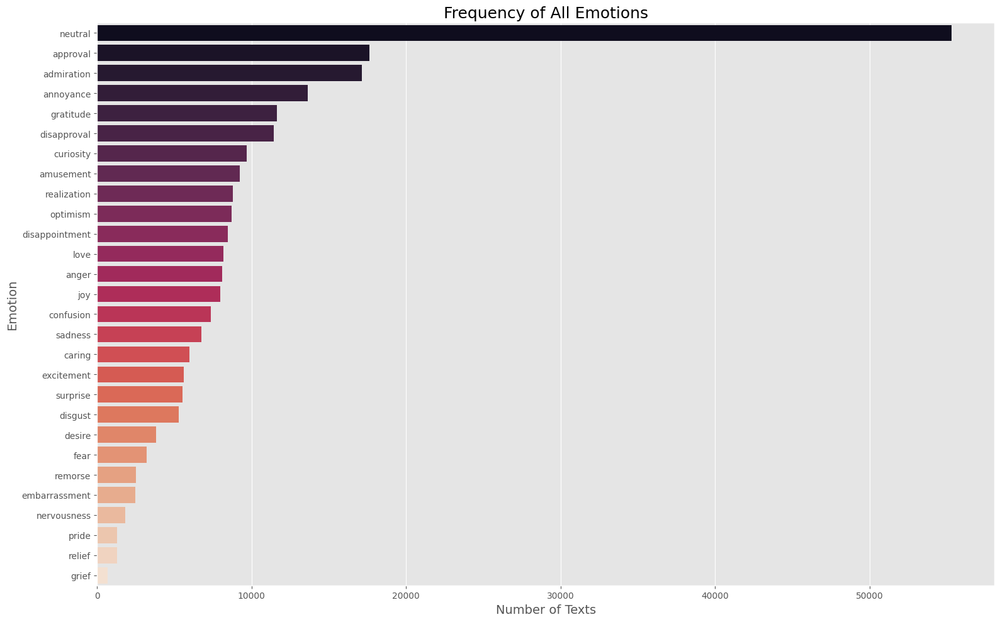

In [3]:
# Load data
print("Loading GoEmotions dataset...")
df = pd.read_csv('go_emotions_Reddit dataset.csv')
df = df[~df['example_very_unclear'].astype(bool)]
emotion_cols = [col for col in df.columns if col not in ['text', 'id', 'example_very_unclear']]
df['cleaned_text'] = df['text'].apply(clean_text)

# 1. Emotion Distribution - ALL EMOTIONS
print("\n=== EMOTION DISTRIBUTION ===")
emotion_counts = df[emotion_cols].sum().sort_values(ascending=False)
plt.figure(figsize=(16, 10))
sns.barplot(x=emotion_counts.values, y=emotion_counts.index, palette='rocket')
plt.title('Frequency of All Emotions', fontsize=18)
plt.xlabel('Number of Texts', fontsize=14)
plt.ylabel('Emotion', fontsize=14)
plt.tight_layout()
plt.show()

2. Word Clouds for all emotions


=== WORD CLOUDS FOR ALL EMOTIONS ===

Generating word cloud for admiration (17131 texts)


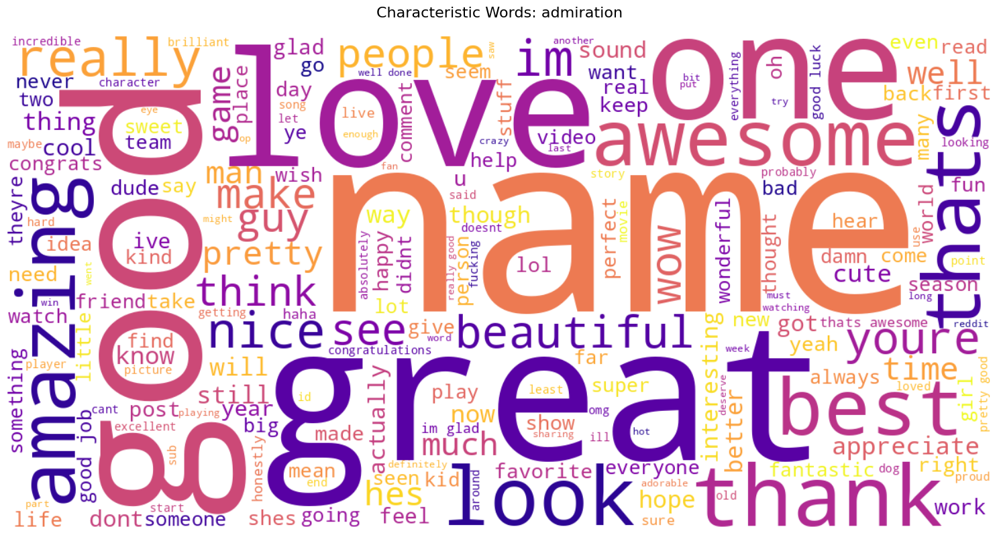


Generating word cloud for amusement (9245 texts)


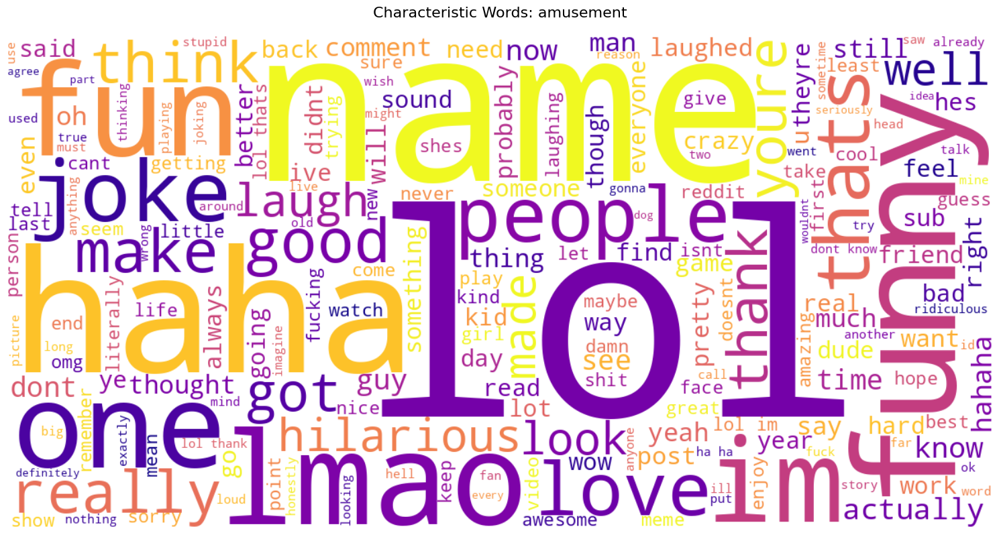


Generating word cloud for anger (8084 texts)


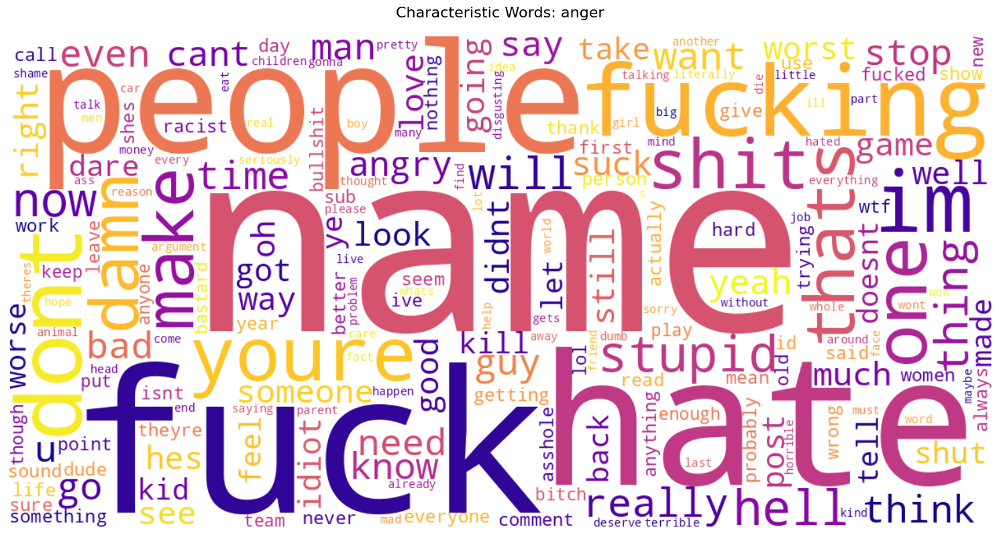


Generating word cloud for annoyance (13618 texts)


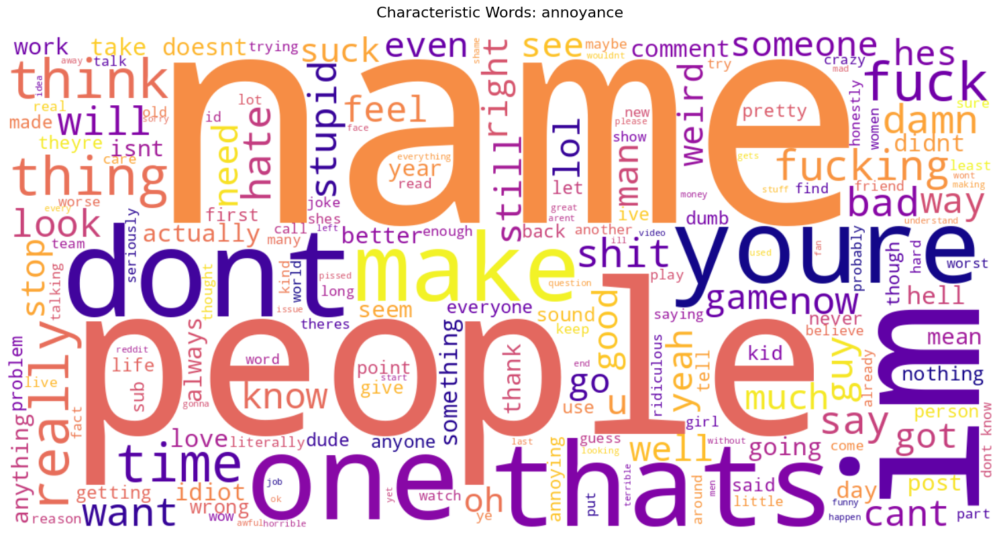


Generating word cloud for approval (17620 texts)


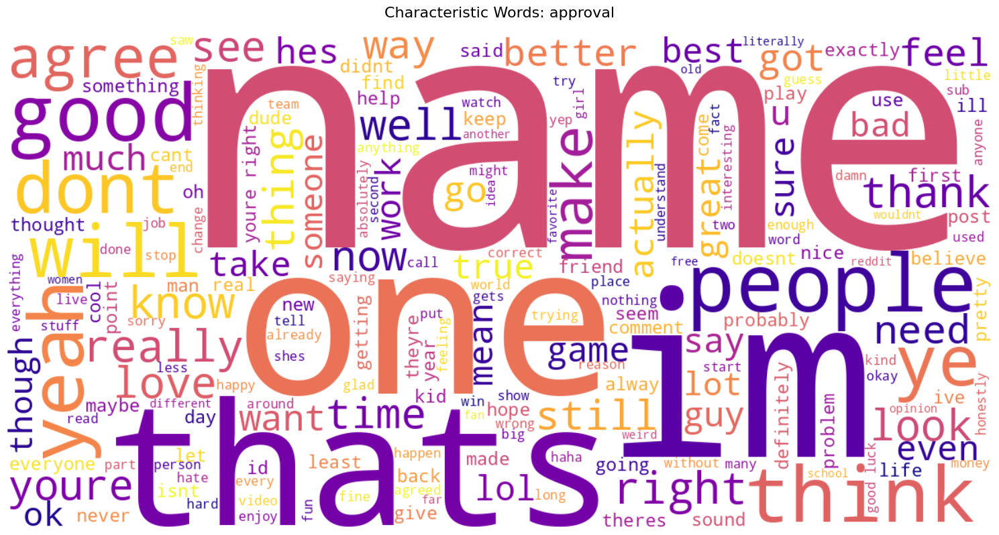


Generating word cloud for caring (5999 texts)


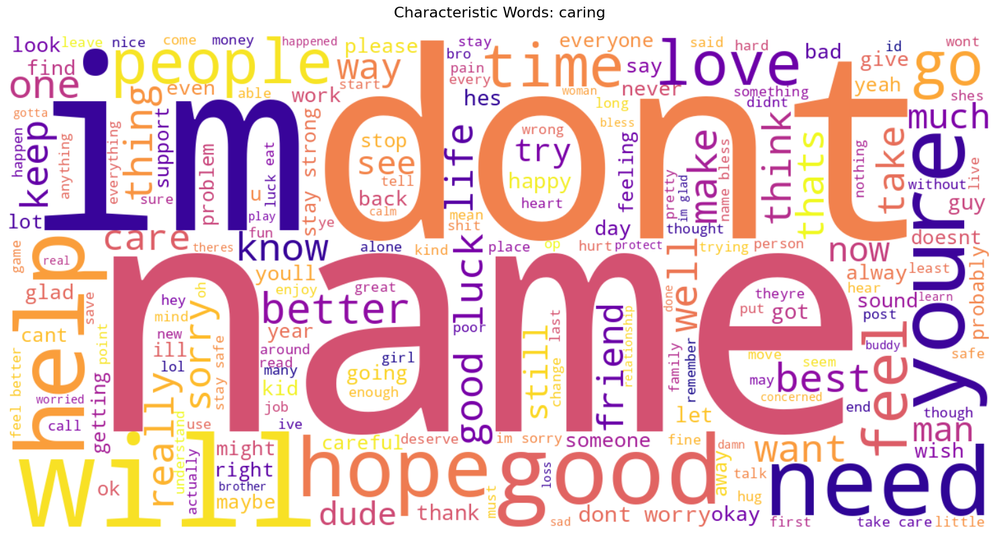


Generating word cloud for confusion (7359 texts)


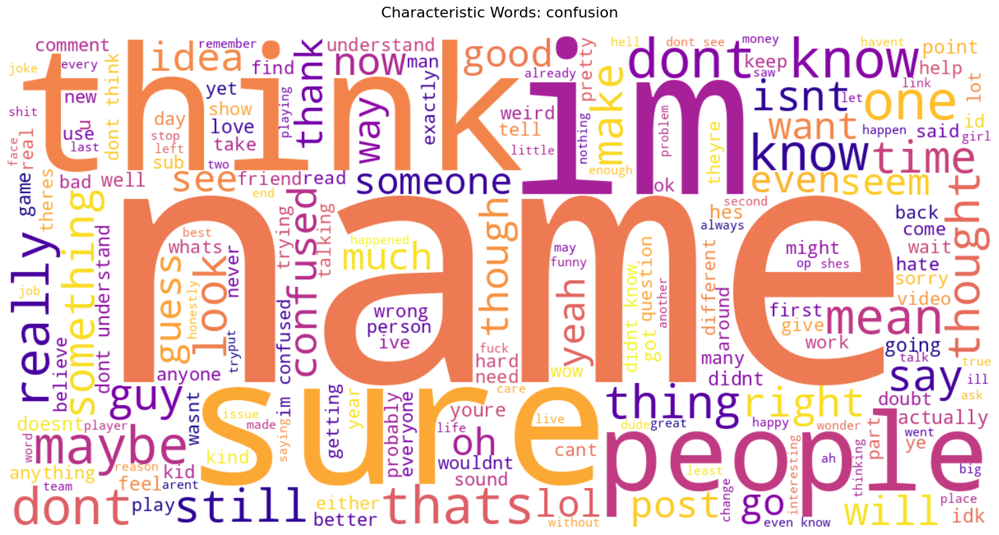


Generating word cloud for curiosity (9692 texts)


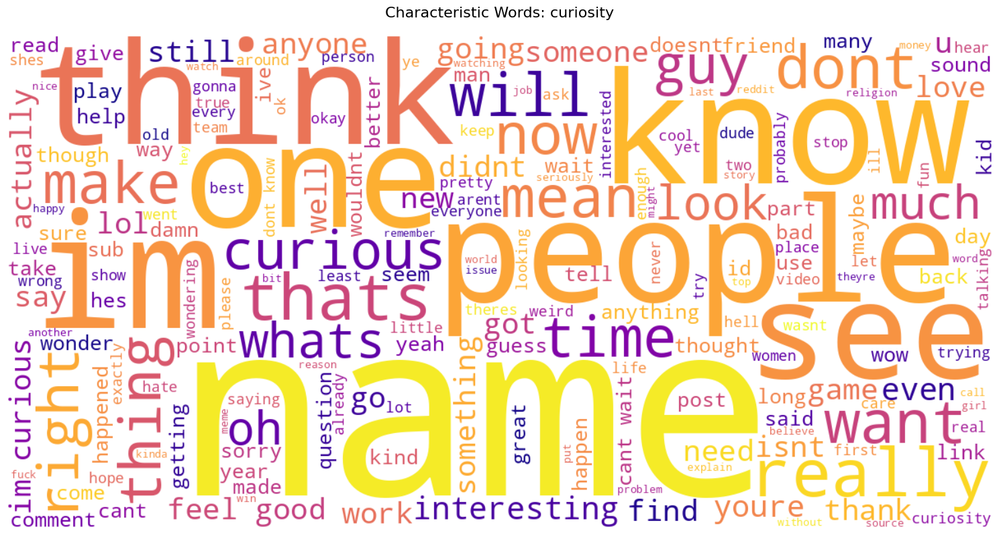


Generating word cloud for desire (3817 texts)


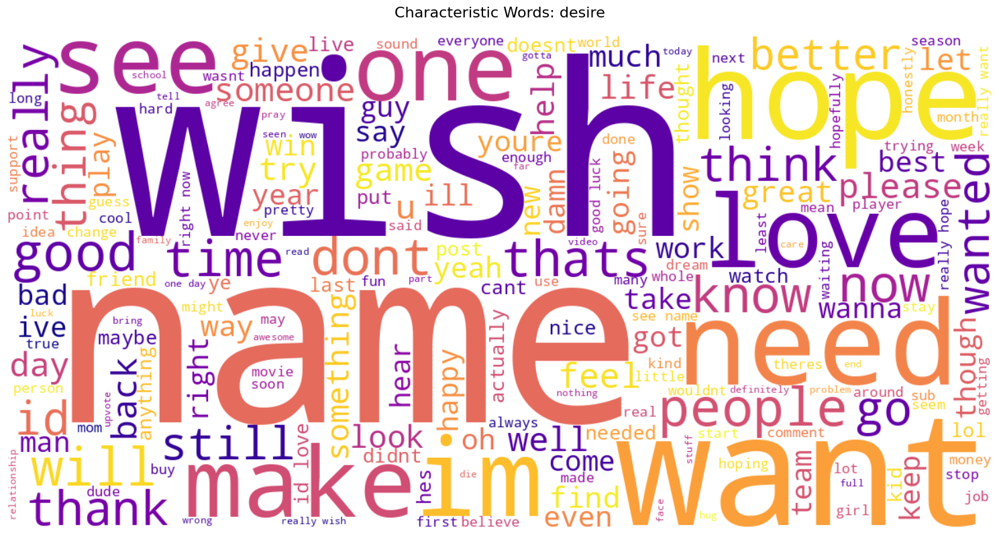


Generating word cloud for disappointment (8469 texts)


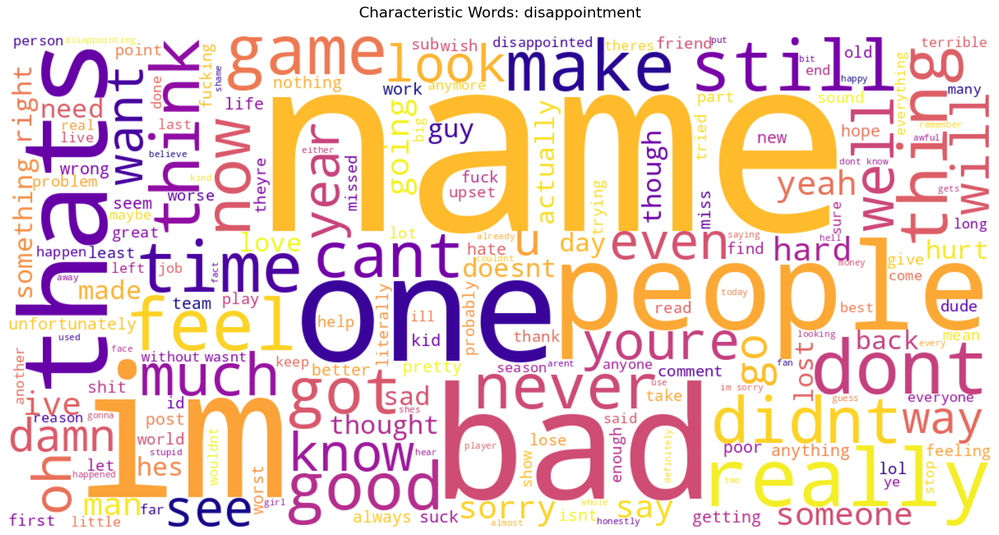


Generating word cloud for disapproval (11424 texts)


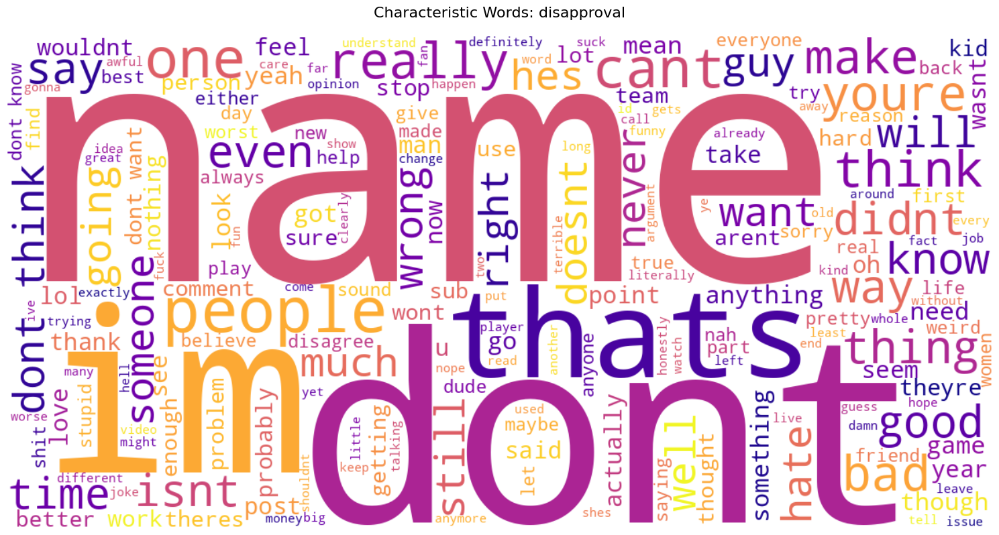


Generating word cloud for disgust (5301 texts)


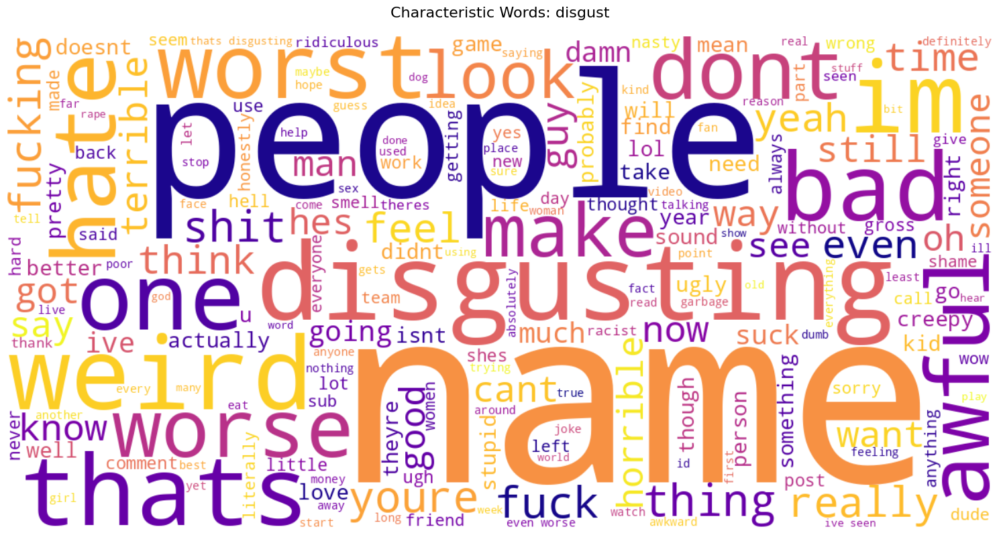


Generating word cloud for embarrassment (2476 texts)


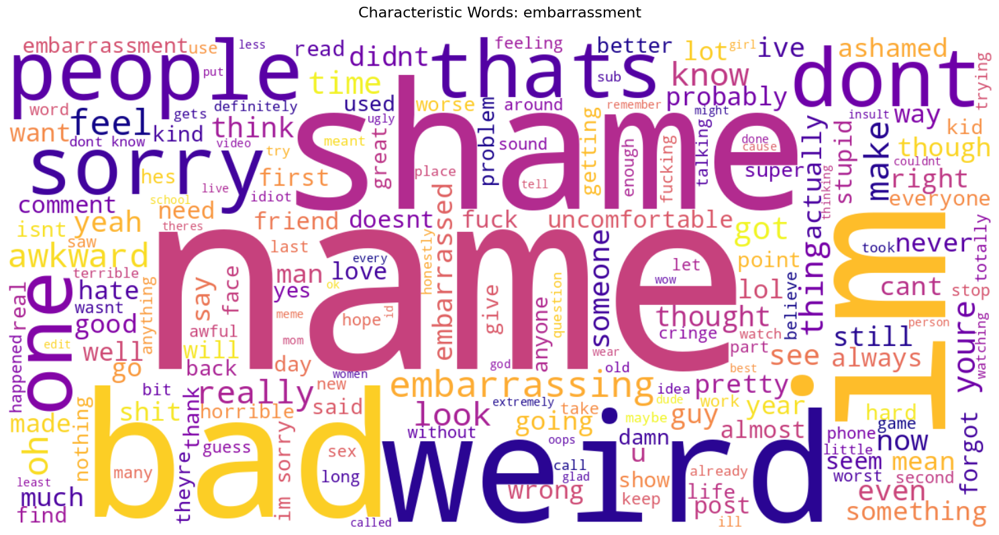


Generating word cloud for excitement (5629 texts)


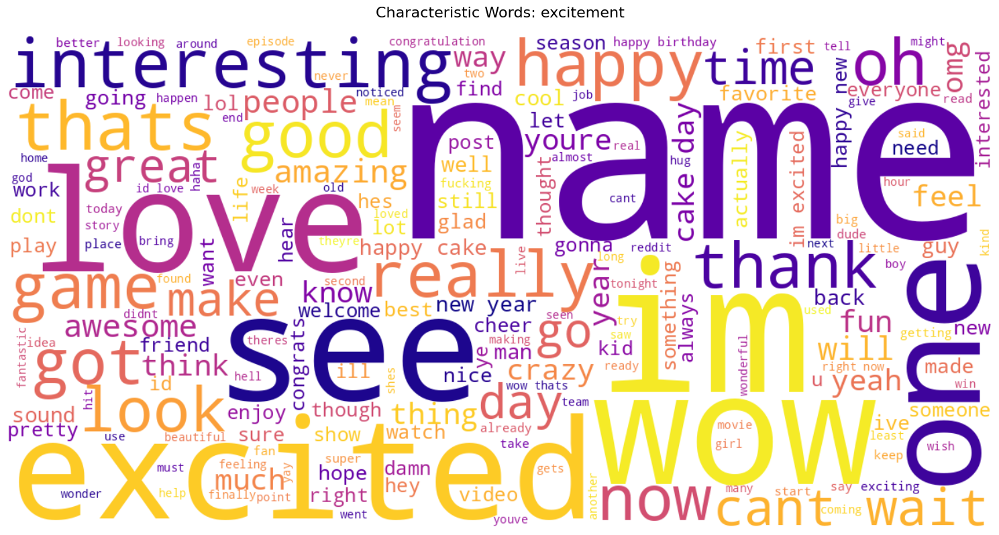


Generating word cloud for fear (3197 texts)


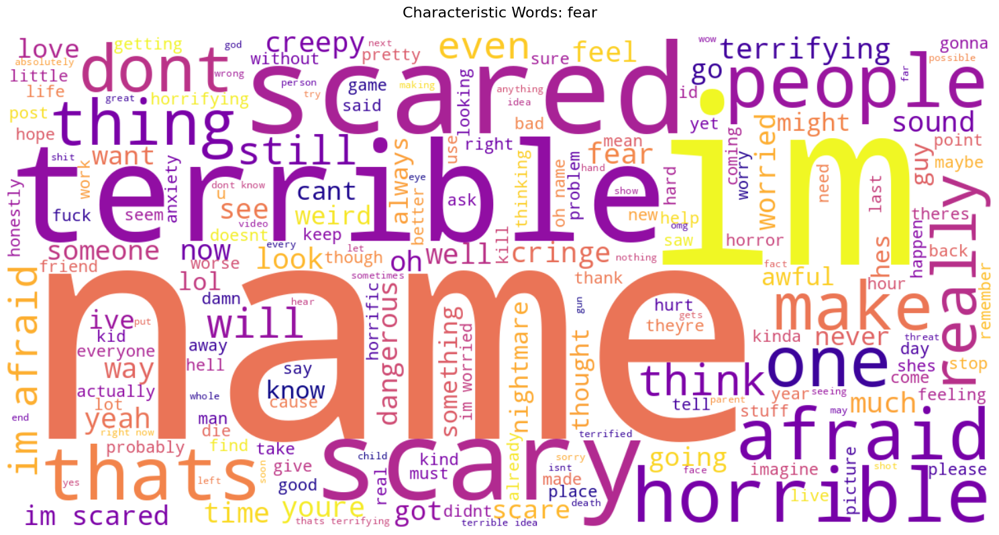


Generating word cloud for gratitude (11625 texts)


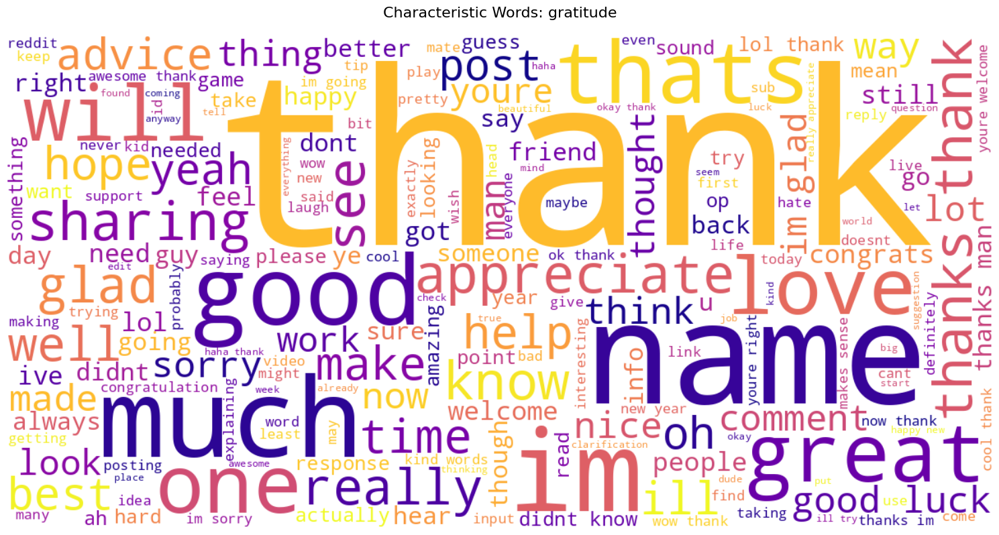


Generating word cloud for grief (673 texts)


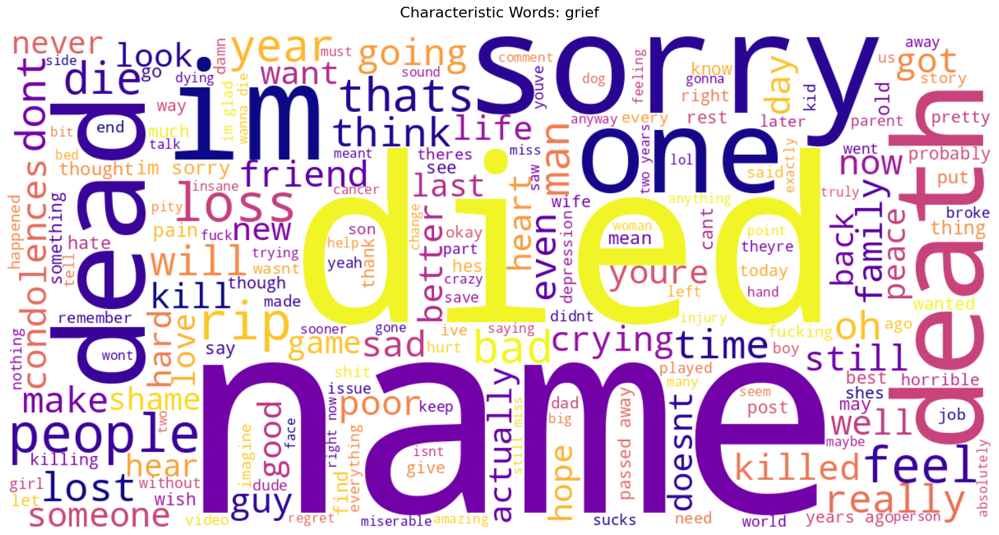


Generating word cloud for joy (7983 texts)


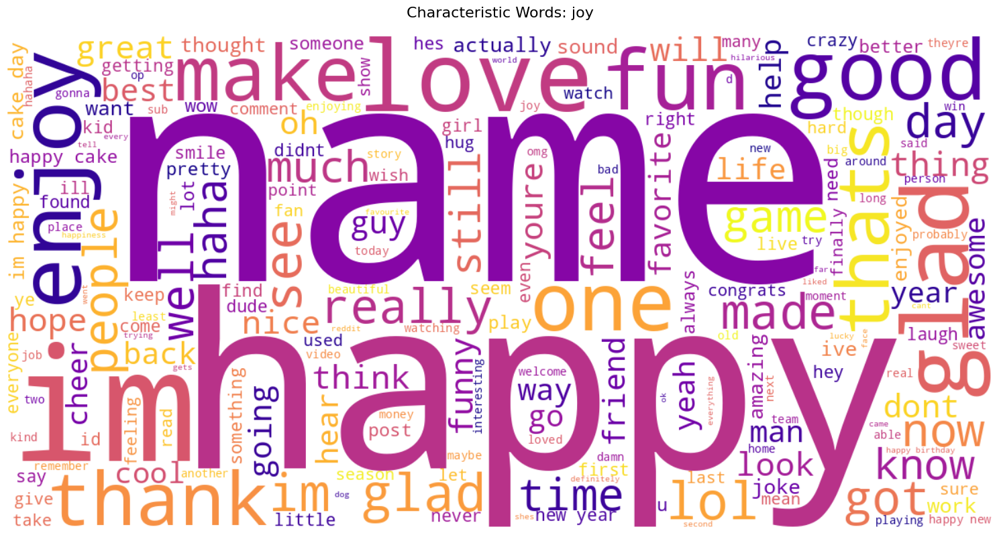


Generating word cloud for love (8191 texts)


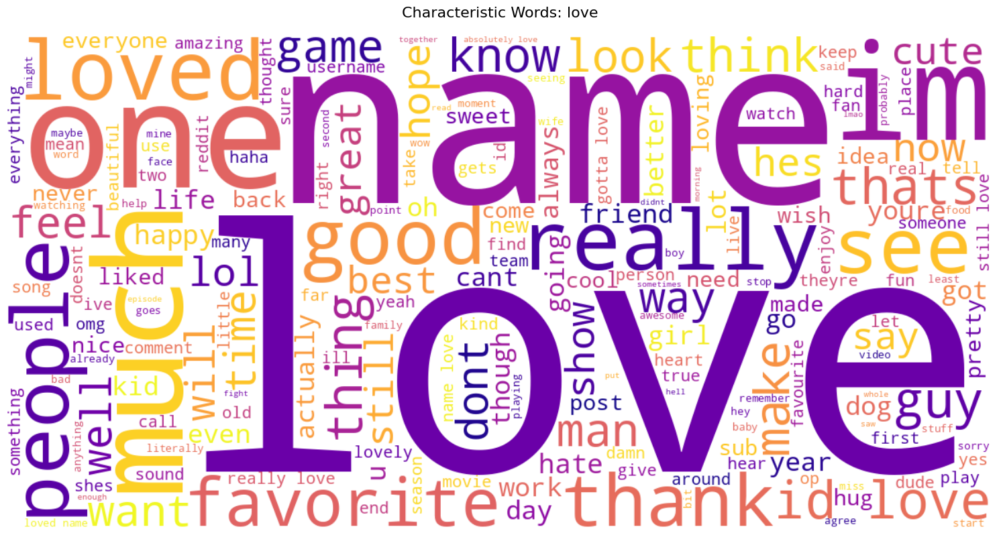


Generating word cloud for nervousness (1810 texts)


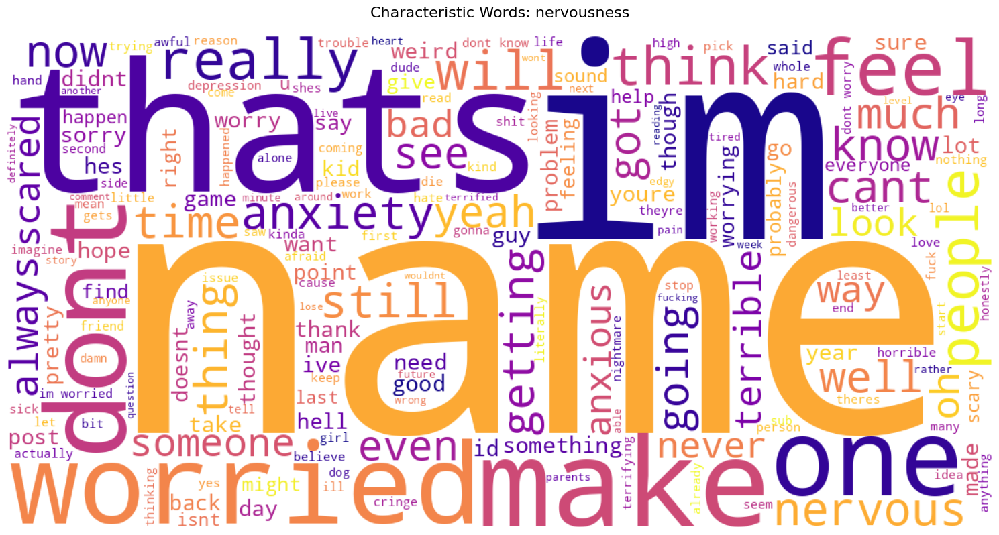


Generating word cloud for optimism (8715 texts)


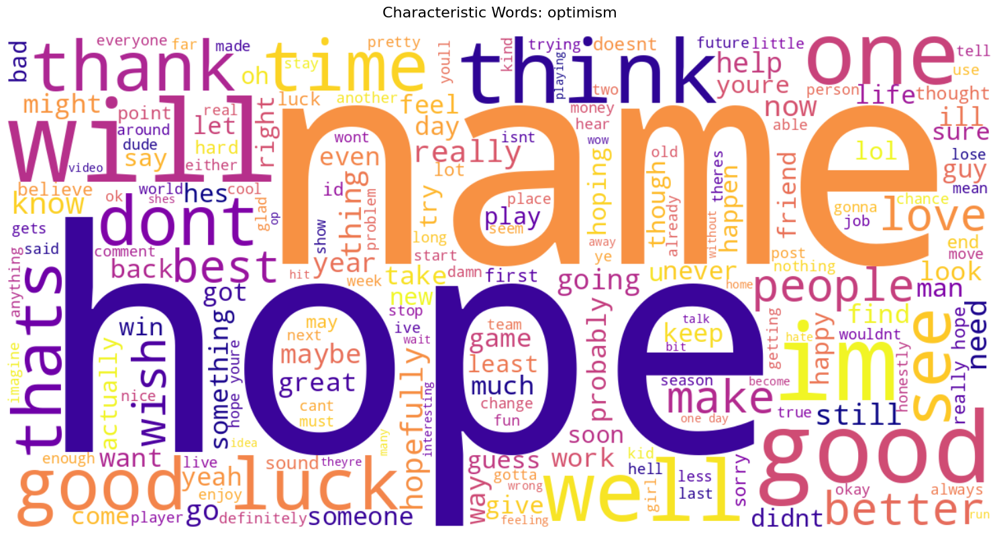


Generating word cloud for pride (1302 texts)


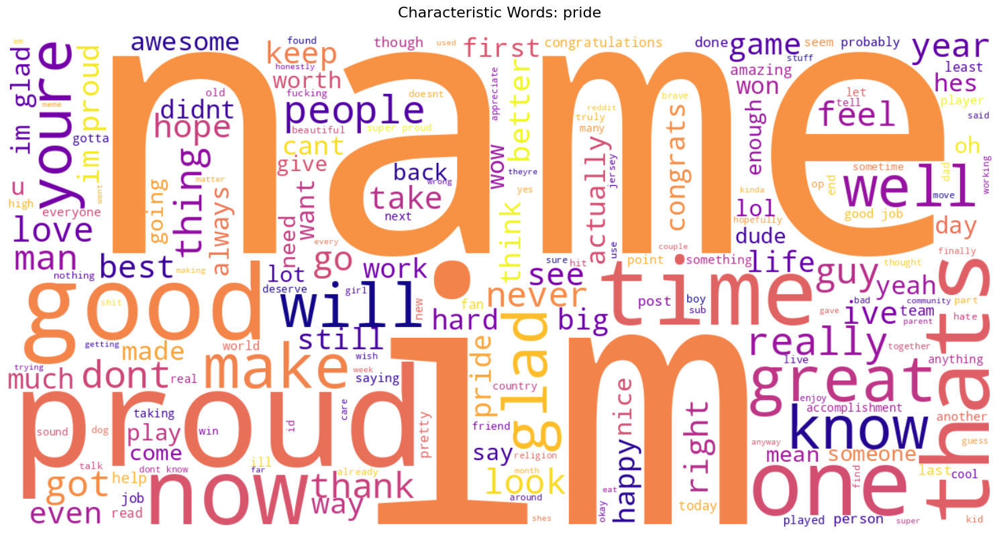


Generating word cloud for realization (8785 texts)


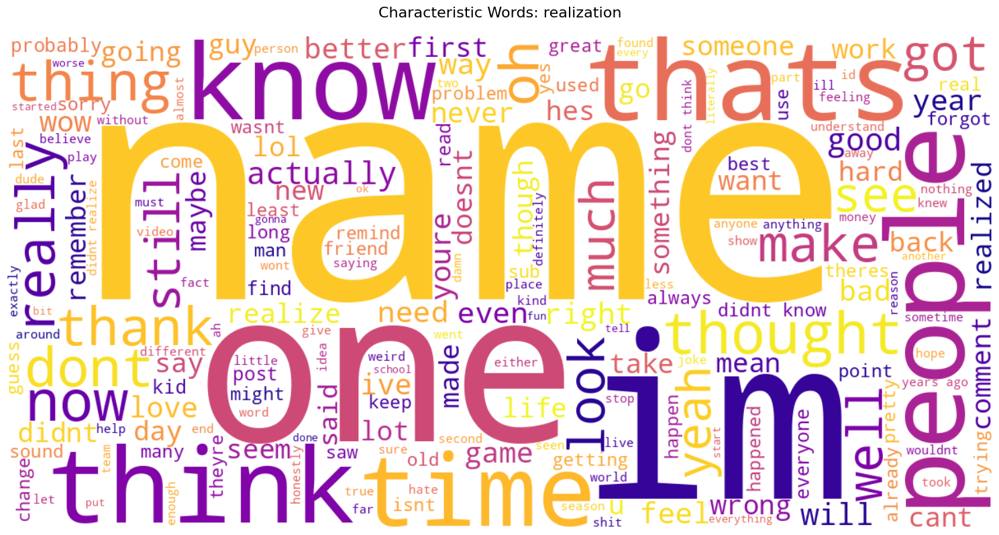


Generating word cloud for relief (1289 texts)


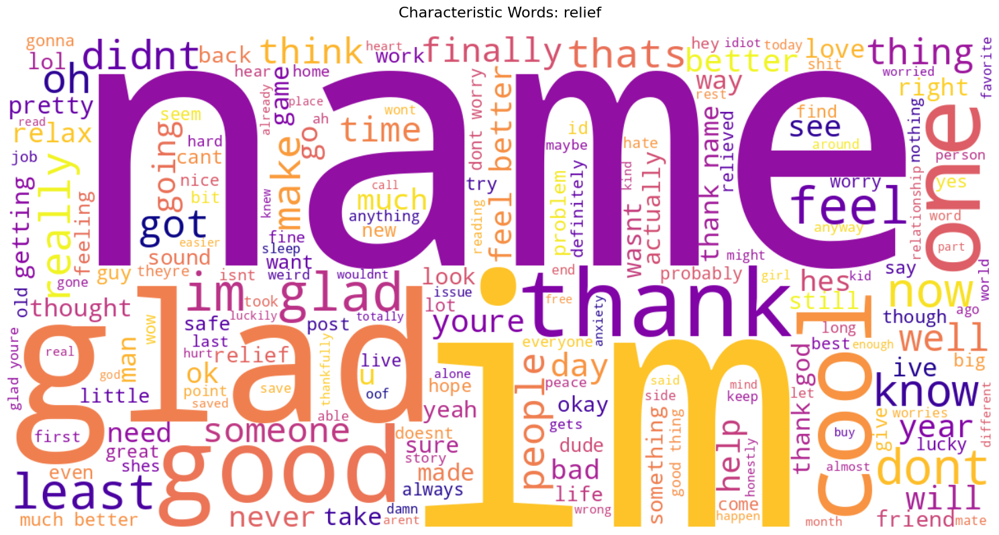


Generating word cloud for remorse (2525 texts)


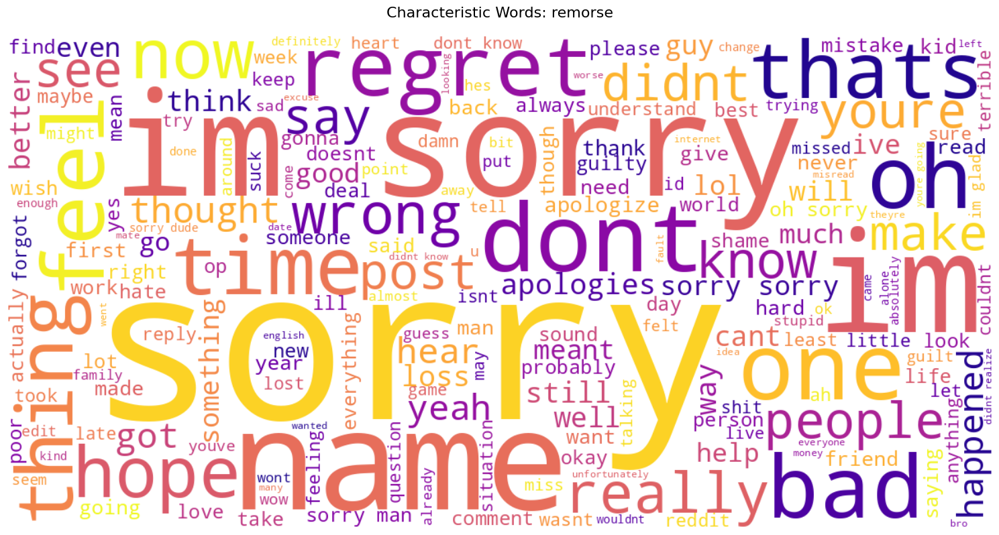


Generating word cloud for sadness (6758 texts)


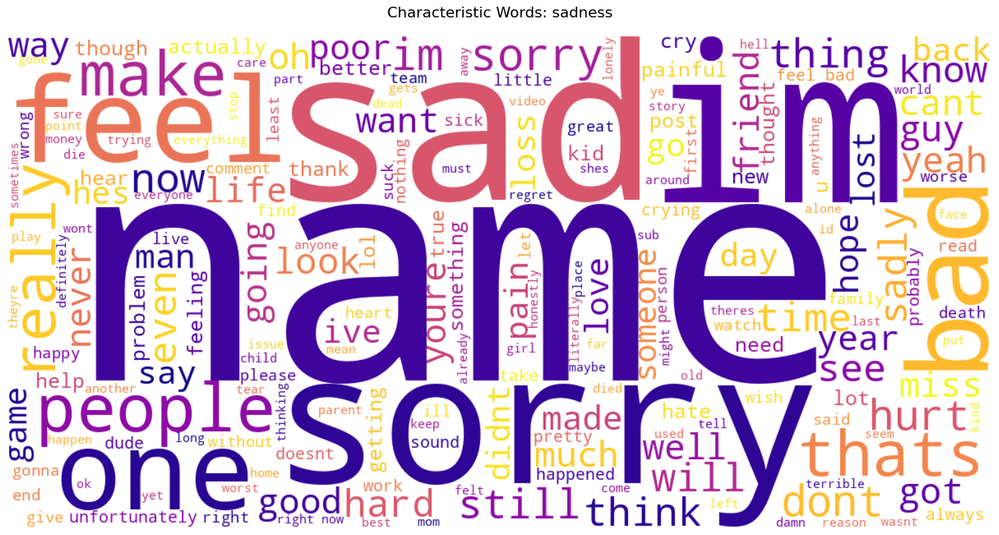


Generating word cloud for surprise (5514 texts)


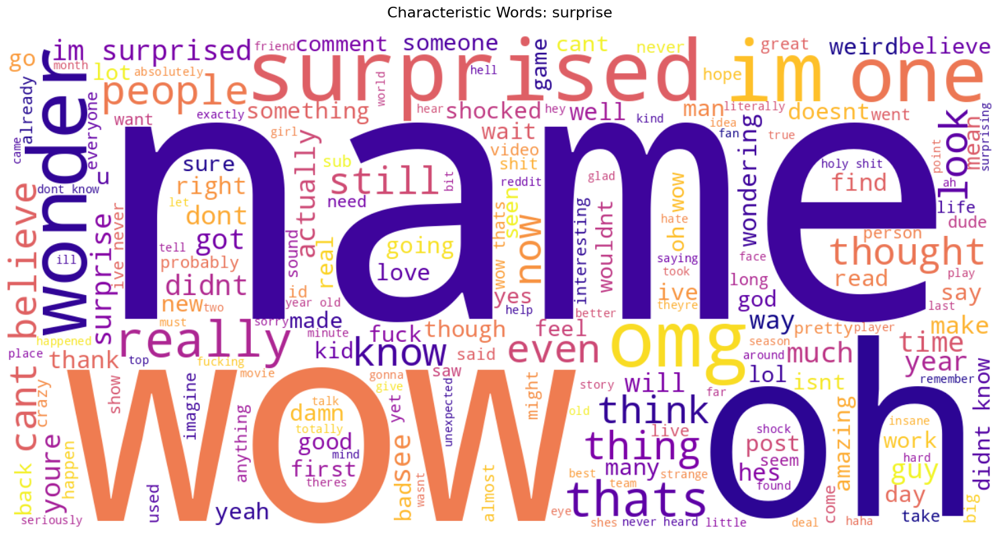


Generating word cloud for neutral (55298 texts)


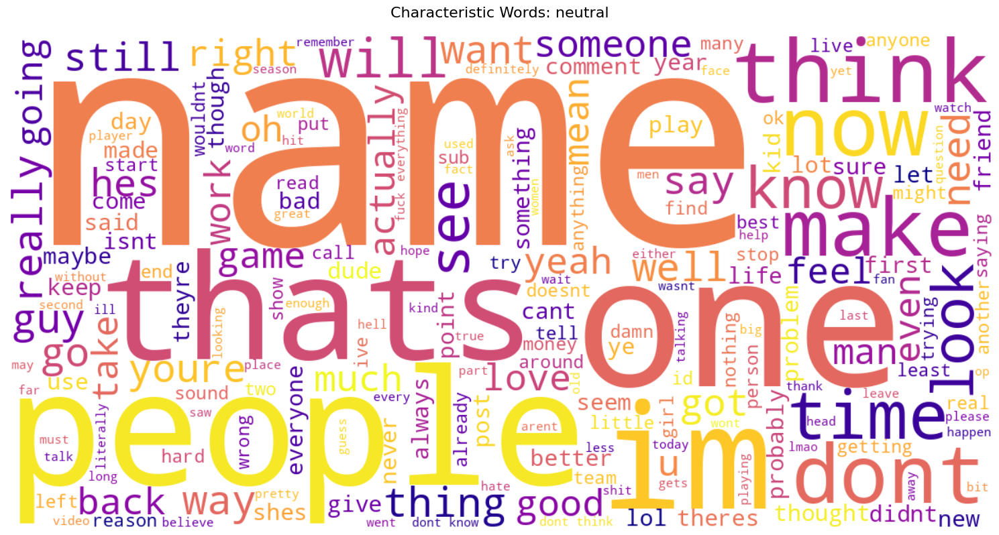

In [4]:
print("\n=== WORD CLOUDS FOR ALL EMOTIONS ===")
for emotion in emotion_cols:
    texts = df[df[emotion] == 1]['cleaned_text']
    if len(texts) > 0:
        print(f"\nGenerating word cloud for {emotion} ({len(texts)} texts)")
        generate_wordcloud(' '.join(texts.astype(str)), emotion, 'plasma')

3. Multi-Label Analysis


=== MULTI-LABEL ANALYSIS ===


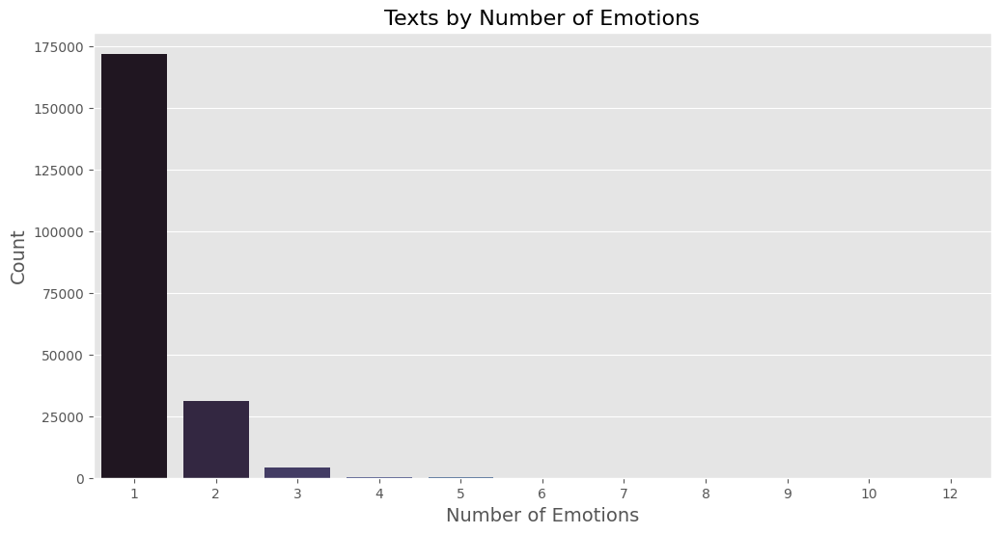

In [5]:
print("\n=== MULTI-LABEL ANALYSIS ===")
df['num_emotions'] = df[emotion_cols].sum(axis=1)
multi_label_dist = df['num_emotions'].value_counts().sort_index()

plt.figure(figsize=(12, 6))
sns.barplot(x=multi_label_dist.index, y=multi_label_dist.values, palette='mako')
plt.title('Texts by Number of Emotions', fontsize=16)
plt.xlabel('Number of Emotions', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.show()

4. Sentiment Analysis by emotions


=== SENTIMENT ANALYSIS BY EMOTION ===


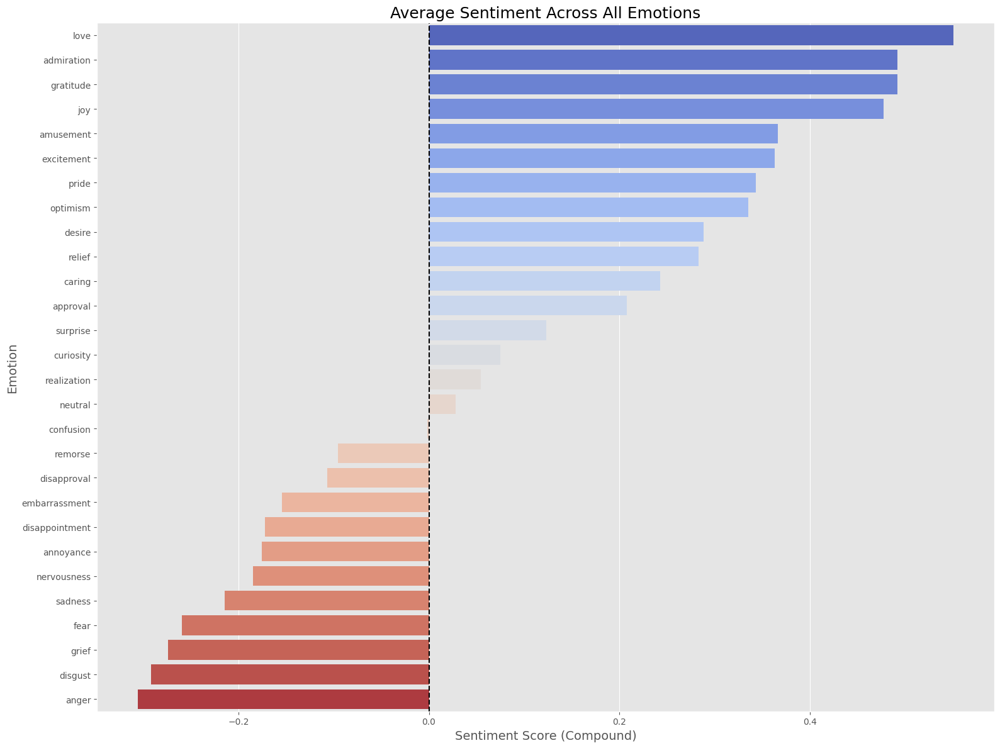

In [6]:
print("\n=== SENTIMENT ANALYSIS BY EMOTION ===")
sia = SentimentIntensityAnalyzer()
sentiment_results = []

for emotion in emotion_cols:
    subset = df[df[emotion] == 1]
    if len(subset) > 0:
        sentiments = subset['cleaned_text'].apply(lambda x: sia.polarity_scores(str(x))['compound'])
        sentiment_results.append({
            'emotion': emotion,
            'count': len(subset),
            'mean_sentiment': sentiments.mean(),
            'median_sentiment': sentiments.median(),
            'min_sentiment': sentiments.min(),
            'max_sentiment': sentiments.max()
        })

# Convert to DataFrame and sort
sentiment_df = pd.DataFrame(sentiment_results).sort_values('mean_sentiment', ascending=False)

# Plot sentiment for all emotions
plt.figure(figsize=(16, 12))
sns.barplot(x='mean_sentiment', y='emotion', data=sentiment_df, palette='coolwarm')
plt.axvline(0, color='black', linestyle='--')
plt.title('Average Sentiment Across All Emotions', fontsize=18)
plt.xlabel('Sentiment Score (Compound)', fontsize=14)
plt.ylabel('Emotion', fontsize=14)
plt.tight_layout()
plt.show()

5. Text Length Analysis


=== TEXT LENGTH BY EMOTION ===


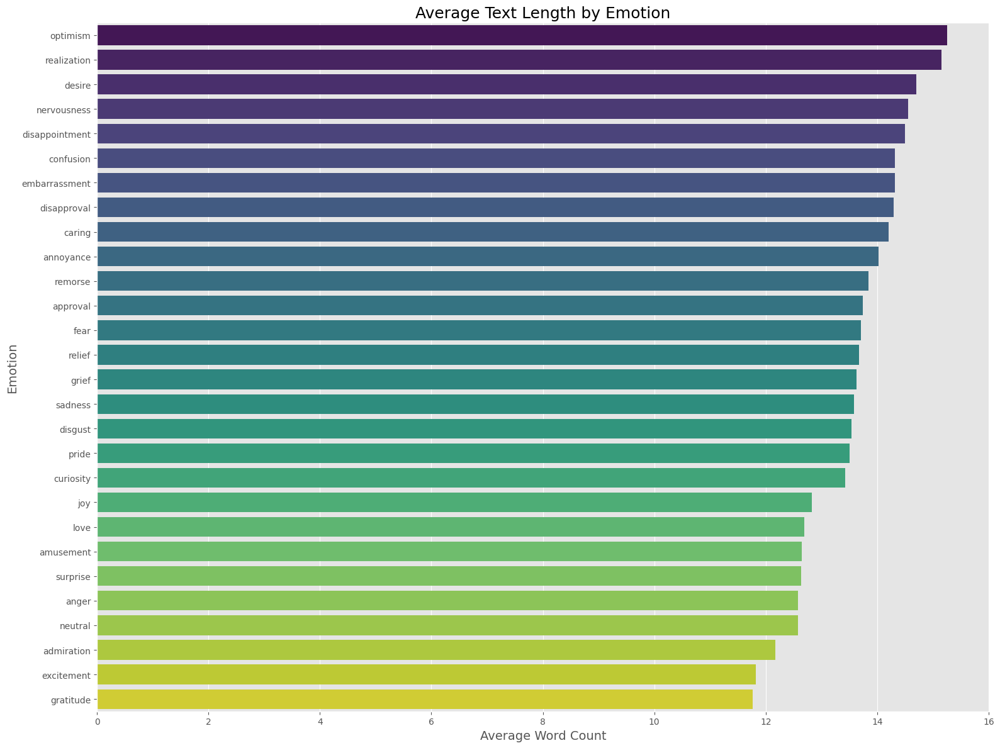

In [7]:
print("\n=== TEXT LENGTH BY EMOTION ===")
df['text_length'] = df['cleaned_text'].apply(lambda x: len(x.split()))
length_results = []

for emotion in emotion_cols:
    subset = df[df[emotion] == 1]
    if len(subset) > 0:
        lengths = subset['text_length']
        length_results.append({
            'emotion': emotion,
            'mean_length': lengths.mean(),
            'median_length': lengths.median(),
            'min_length': lengths.min(),
            'max_length': lengths.max()
        })

length_df = pd.DataFrame(length_results).sort_values('mean_length', ascending=False)

# Plot text length for all emotions
plt.figure(figsize=(16, 12))
sns.barplot(x='mean_length', y='emotion', data=length_df, palette='viridis')
plt.title('Average Text Length by Emotion', fontsize=18)
plt.xlabel('Average Word Count', fontsize=14)
plt.ylabel('Emotion', fontsize=14)
plt.tight_layout()
plt.show()

6. Emotion Co-occurrence Matrix


=== EMOTION CO-OCCURRENCE ===


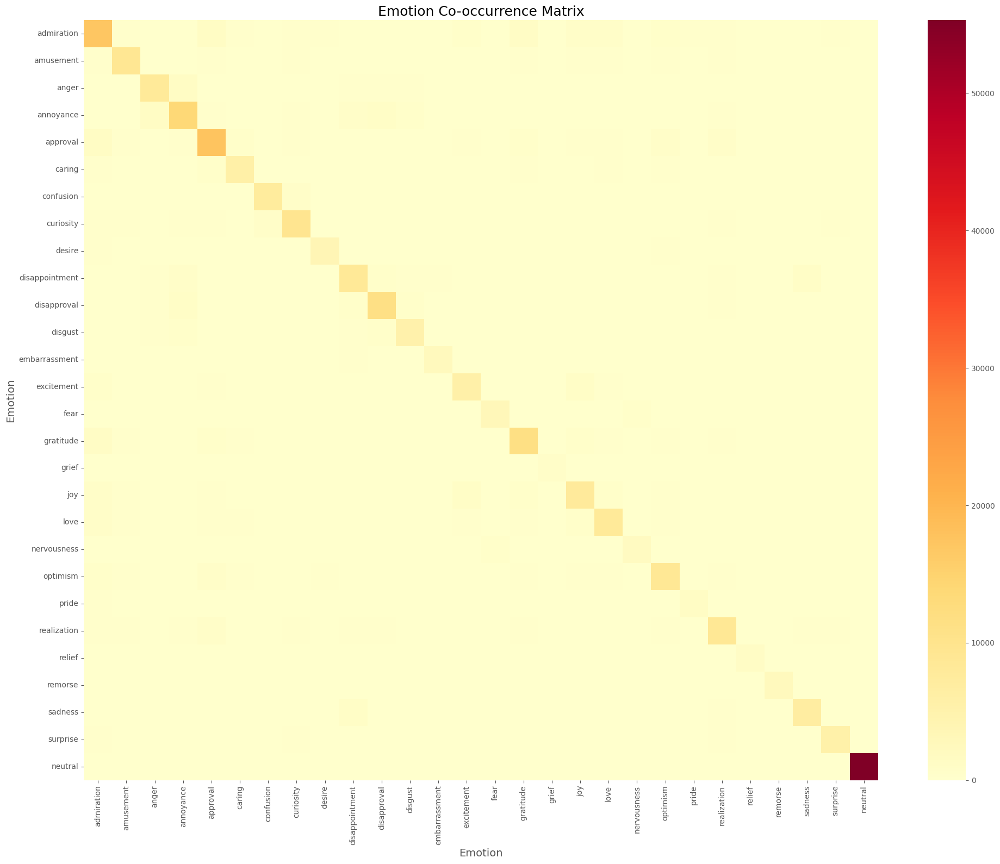


=== ANALYSIS COMPLETE FOR ALL 28 EMOTIONS ===


In [8]:
print("\n=== EMOTION CO-OCCURRENCE ===")
cooccurrence = df[emotion_cols].T.dot(df[emotion_cols])

plt.figure(figsize=(20, 16))
sns.heatmap(cooccurrence, cmap='YlOrRd', annot=False, fmt='d')
plt.title('Emotion Co-occurrence Matrix', fontsize=18)
plt.xlabel('Emotion', fontsize=14)
plt.ylabel('Emotion', fontsize=14)
plt.tight_layout()
plt.show()

print("\n=== ANALYSIS COMPLETE FOR ALL 28 EMOTIONS ===")

(2) EDA for Sentiment Analysis for Mental Health_reddit.csv contains the following:
- Word clouds for ALL statuses
- Status distribution
- Sentiment analysis by status
- Text length analysis

In [9]:
# Text cleaning
def clean_text(text):
    if not isinstance(text, str):
        return ""
    text = text.lower()
    text = re.sub(r'http\S+|www\S+|https\S+', '', text, flags=re.MULTILINE)
    text = re.sub(r'\@\w+|\#', '', text)
    text = re.sub(r'[^\w\s]', '', text)
    text = re.sub(r'\s+', ' ', text).strip()
    return text

# Status word cloud function
def generate_status_wordcloud(text, title):
    wordcloud = WordCloud(width=1200, height=600,
                         background_color='white',
                         stopwords=set(STOPWORDS),
                         max_words=200,
                         colormap='viridis').generate(text)
    plt.figure(figsize=(14, 7))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f'Status: {title}', fontsize=16, pad=20)
    plt.tight_layout()
    plt.show()

# Load data
print("Loading Mental Health Sentiment dataset...")
mental_health = pd.read_csv('Sentiment Analysis for Mental Health_reddit.csv')

# Clean data
mental_health_clean = mental_health.copy()
if mental_health_clean.columns[0] == 'Unnamed: 0':
    mental_health_clean = mental_health_clean.rename(columns={'Unnamed: 0': 'id'})

mental_health_clean['statement'] = mental_health_clean['statement'].fillna('')
mental_health_clean['status'] = mental_health_clean['status'].fillna('Unknown')
mental_health_clean['cleaned_text'] = mental_health_clean['statement'].apply(clean_text)

Loading Mental Health Sentiment dataset...


Basic information of the dataset and status distribution


=== BASIC DATASET INFO ===
Shape: (53044, 4)

Missing values:
id              1
statement       0
status          0
cleaned_text    0
dtype: int64

Status counts:
status
Normal                  16351
Depression              15404
Suicidal                10653
Anxiety                  3888
Bipolar                  2877
Stress                   2669
Personality disorder     1201
Unknown                     1
Name: count, dtype: int64


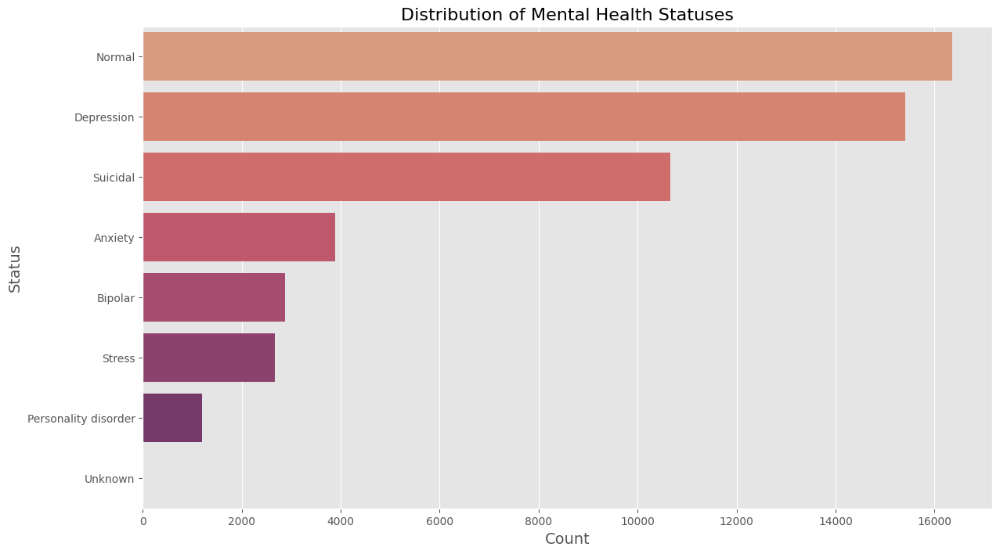

In [10]:
# Basic info
print("\n=== BASIC DATASET INFO ===")
print(f"Shape: {mental_health_clean.shape}")
print("\nMissing values:")
print(mental_health_clean.isnull().sum())

# Status distribution
status_counts = mental_health_clean['status'].value_counts()
print("\nStatus counts:")
print(status_counts)

plt.figure(figsize=(14, 8))
sns.barplot(x=status_counts.values, y=status_counts.index, palette='flare')
plt.title('Distribution of Mental Health Statuses', fontsize=16)
plt.xlabel('Count', fontsize=14)
plt.ylabel('Status', fontsize=14)
plt.show()

Word clouds for all mental health statuses


=== Mental health STATUS WORD CLOUDS ===


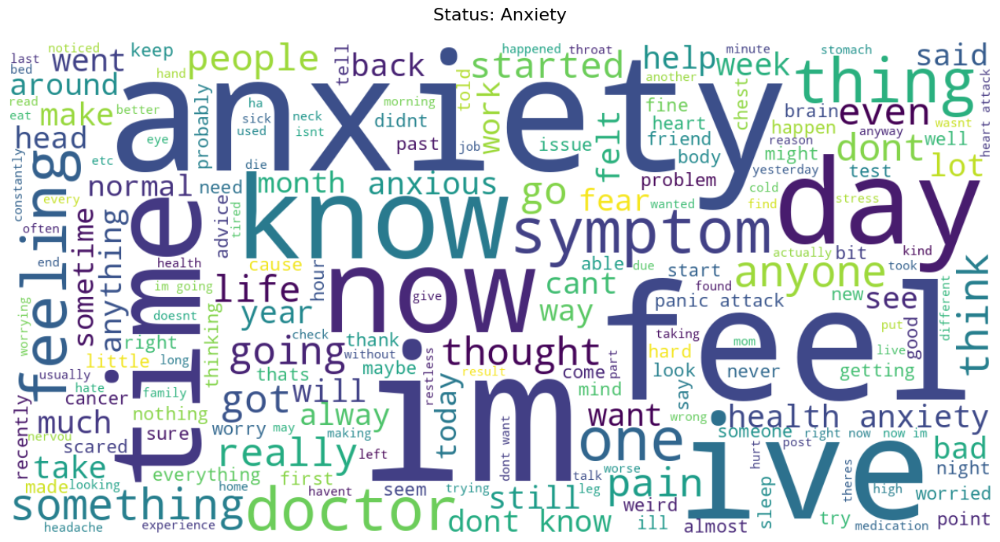

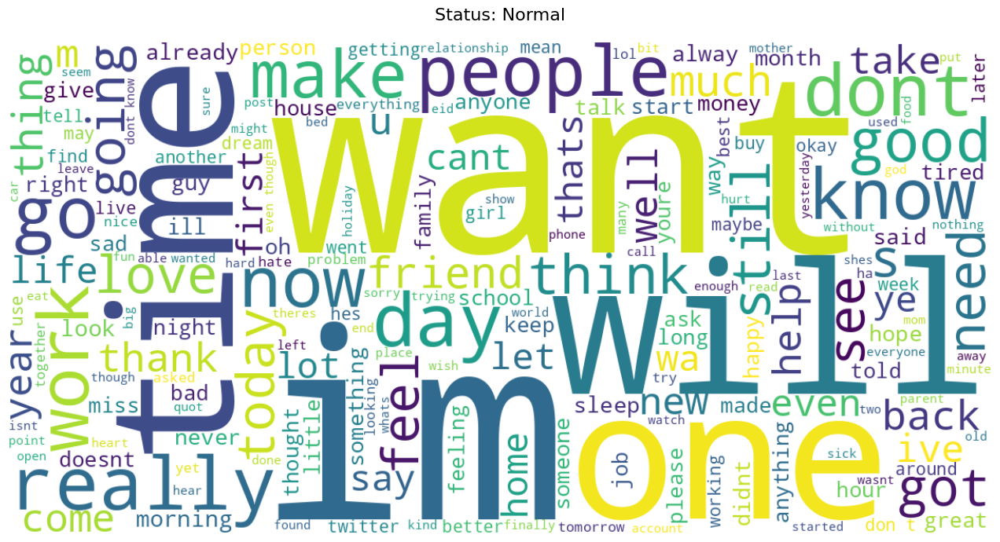

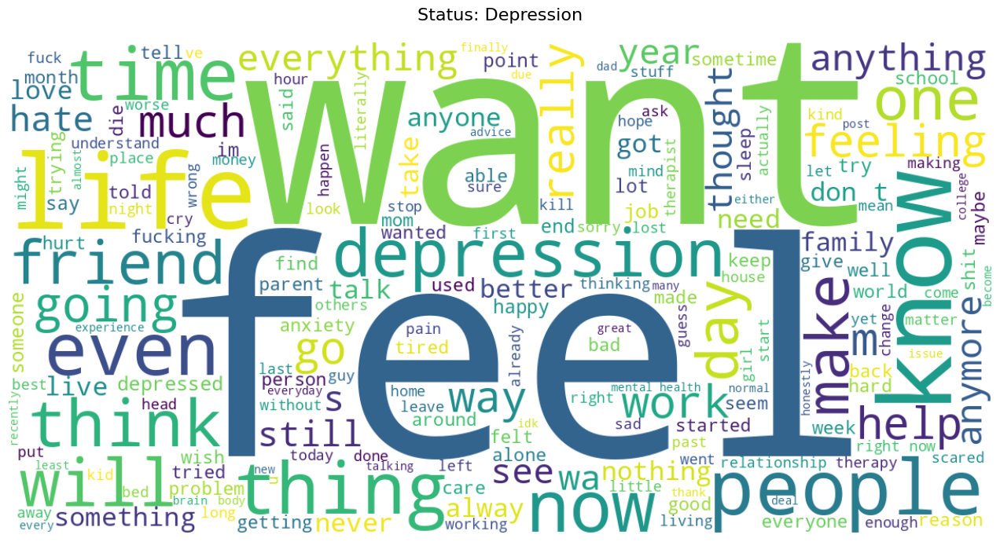

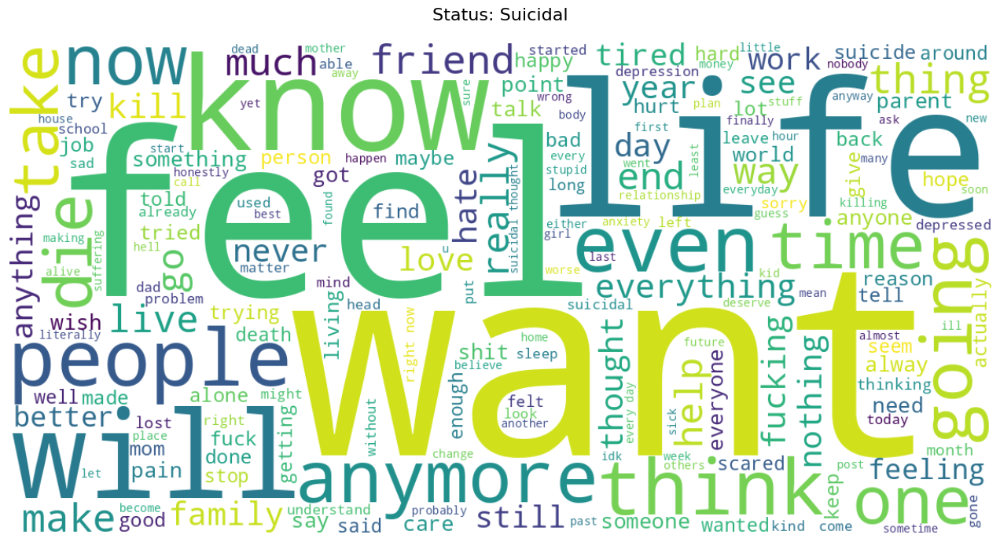

Skipping Unknown - only 1 samples


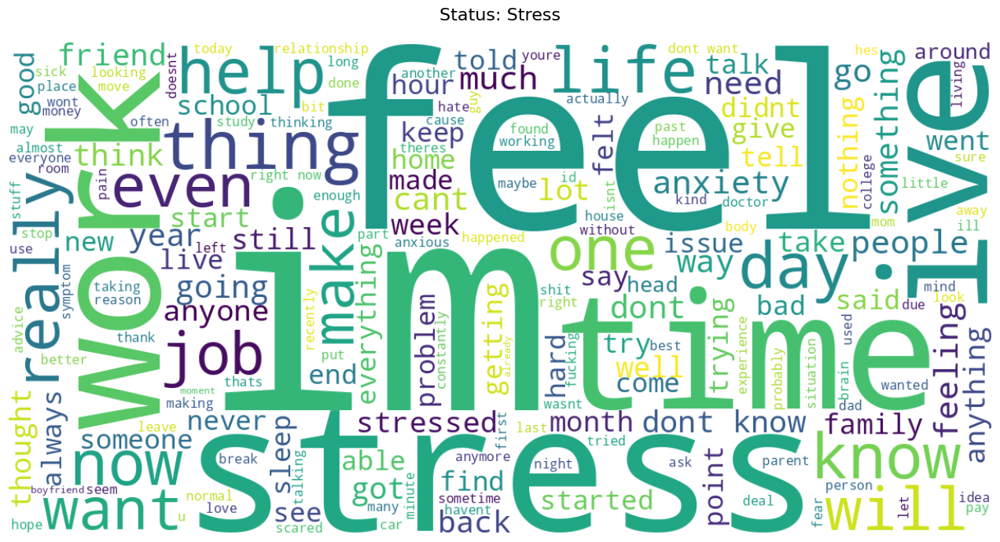

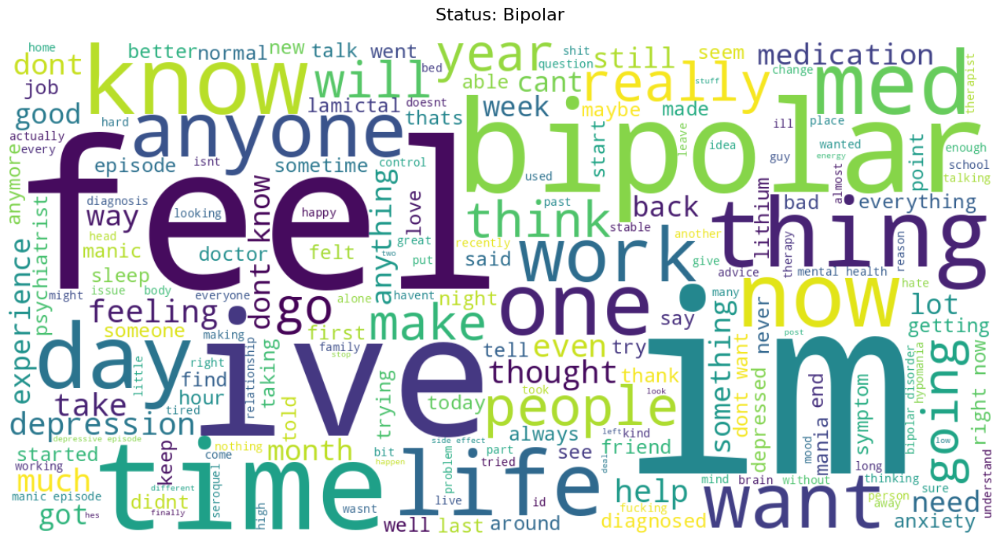

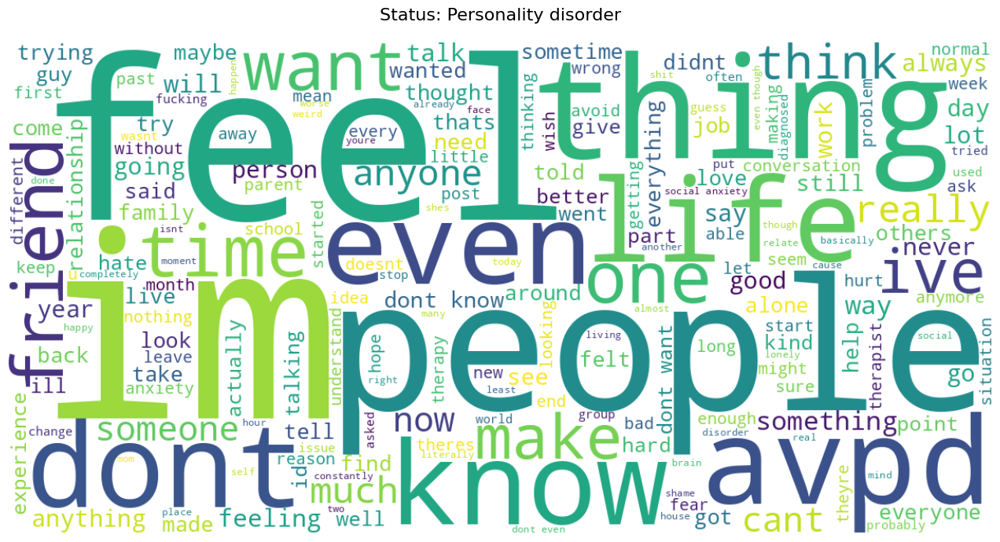

In [21]:
print("\n=== Mental health STATUS WORD CLOUDS ===")
for status in mental_health_clean['status'].unique():
    subset = mental_health_clean[mental_health_clean['status'] == status]
    if len(subset) >= 3:  # Minimum 3 samples
        combined_text = ' '.join(subset['cleaned_text'].astype(str))
        generate_status_wordcloud(combined_text, status)
    else:
        print(f"Skipping {status} - only {len(subset)} samples")

Sentiment analysis


=== SENTIMENT ANALYSIS ===


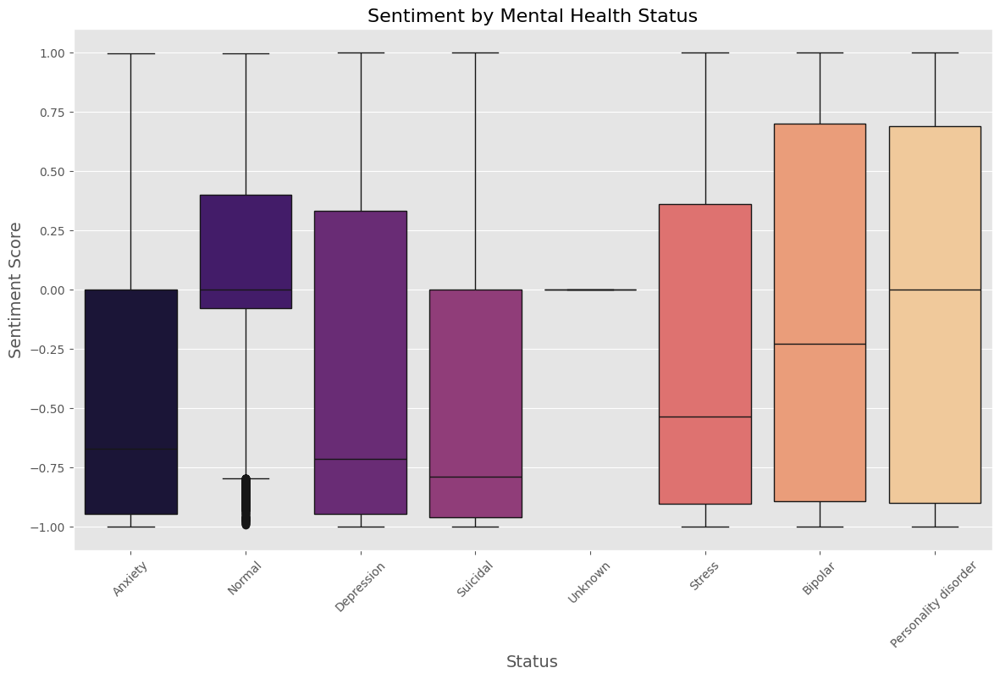

In [12]:
print("\n=== SENTIMENT ANALYSIS ===")
sia = SentimentIntensityAnalyzer()
mental_health_clean['sentiment'] = mental_health_clean['cleaned_text'].apply(
    lambda x: sia.polarity_scores(str(x))['compound'])

plt.figure(figsize=(14, 8))
sns.boxplot(x='status', y='sentiment', data=mental_health_clean, palette='magma')
plt.title('Sentiment by Mental Health Status', fontsize=16)
plt.xlabel('Status', fontsize=14)
plt.ylabel('Sentiment Score', fontsize=14)
plt.xticks(rotation=45)
plt.show()

Text length analysis


=== TEXT LENGTH ANALYSIS ===
count    53044.000000
mean       112.120391
std        163.228632
min          0.000000
25%         15.000000
50%         61.000000
75%        147.000000
max       6300.000000
Name: text_length, dtype: float64


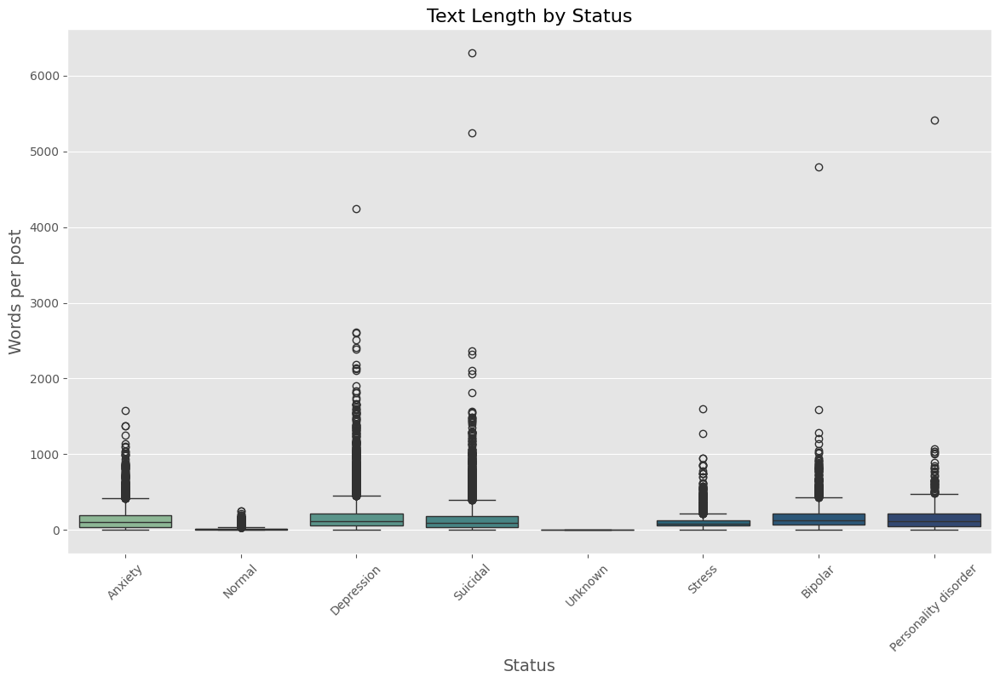

In [13]:
mental_health_clean['text_length'] = mental_health_clean['cleaned_text'].apply(lambda x: len(x.split()))
print("\n=== TEXT LENGTH ANALYSIS ===")
print(mental_health_clean['text_length'].describe())

plt.figure(figsize=(14, 8))
sns.boxplot(x='status', y='text_length', data=mental_health_clean, palette='crest')
plt.title('Text Length by Status', fontsize=16)
plt.xlabel('Status', fontsize=14)
plt.ylabel('Words per post', fontsize=14)
plt.xticks(rotation=45)
plt.show()

Detailed status analysis

In [14]:
print("\n=== DETAILED STATUS ANALYSIS ===")
for status in status_counts.index:
    subset = mental_health_clean[mental_health_clean['status'] == status]
    print(f"\nStatus: {status} (n={len(subset)})")
    print("Avg text length:", subset['text_length'].mean())
    print("Sentiment scores:")
    print(subset['sentiment'].describe())

print("\n===== MENTAL HEALTH SENTIMENT ANALYSIS COMPLETE =====")


=== DETAILED STATUS ANALYSIS ===

Status: Normal (n=16351)
Avg text length: 17.07944468228243
Sentiment scores:
count    16351.000000
mean         0.085448
std          0.423834
min         -0.990600
25%         -0.077200
50%          0.000000
75%          0.401900
max          0.998600
Name: sentiment, dtype: float64

Status: Depression (n=15404)
Avg text length: 167.7838223837964
Sentiment scores:
count    15404.000000
mean        -0.332957
std          0.722126
min         -0.999800
25%         -0.946625
50%         -0.714100
75%          0.332975
max          0.999600
Name: sentiment, dtype: float64

Status: Suicidal (n=10653)
Avg text length: 146.16877874777057
Sentiment scores:
count    10653.000000
mean        -0.428750
std          0.666868
min         -0.999900
25%         -0.959000
50%         -0.787100
75%          0.000000
max          0.999400
Name: sentiment, dtype: float64

Status: Anxiety (n=3888)
Avg text length: 141.63888888888889
Sentiment scores:
count    3888.0000

(3) EDA on mental_health_diagnosis_treatment_.csv contains the following:
- Demographic analysis
- Treatment effectiveness
- Symptom patterns
- Outcome analysis

In [15]:
# Load data
print("Loading Mental Health Diagnosis dataset...")
diagnosis = pd.read_csv('mental_health_diagnosis_treatment_.csv')
diagnosis_clean = diagnosis.copy()

# Convert date column
if 'Treatment Start Date' in diagnosis_clean.columns:
    diagnosis_clean['Treatment Start Date'] = pd.to_datetime(diagnosis_clean['Treatment Start Date'])

# Handle categorical columns
categorical_cols = ['Gender', 'Diagnosis', 'Medication', 'Therapy Type', 'Outcome', 'AI-Detected Emotional State']
for col in categorical_cols:
    if col in diagnosis_clean.columns:
        diagnosis_clean[col] = diagnosis_clean[col].astype('category')

Loading Mental Health Diagnosis dataset...


Basic Dataset information

In [16]:
print("\n=== BASIC DATASET INFO ===")
print(f"Shape: {diagnosis_clean.shape}")
print("\nMissing values:")
print(diagnosis_clean.isnull().sum())


=== BASIC DATASET INFO ===
Shape: (500, 17)

Missing values:
Patient ID                      0
Age                             0
Gender                          0
Diagnosis                       0
Symptom Severity (1-10)         0
Mood Score (1-10)               0
Sleep Quality (1-10)            0
Physical Activity (hrs/week)    0
Medication                      0
Therapy Type                    0
Treatment Start Date            0
Treatment Duration (weeks)      0
Stress Level (1-10)             0
Outcome                         0
Treatment Progress (1-10)       0
AI-Detected Emotional State     0
Adherence to Treatment (%)      0
dtype: int64


Numerical features analysis


=== NUMERICAL FEATURE ANALYSIS ===

Age statistics:
count    500.000000
mean      38.708000
std       12.712433
min       18.000000
25%       28.000000
50%       38.000000
75%       50.000000
max       60.000000
Name: Age, dtype: float64


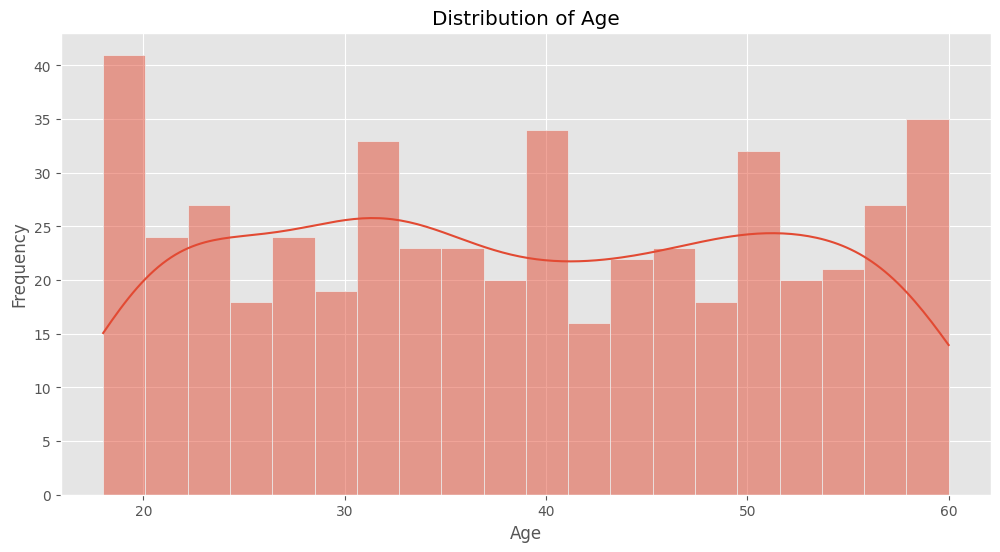


Symptom Severity (1-10) statistics:
count    500.000000
mean       7.478000
std        1.706265
min        5.000000
25%        6.000000
50%        8.000000
75%        9.000000
max       10.000000
Name: Symptom Severity (1-10), dtype: float64


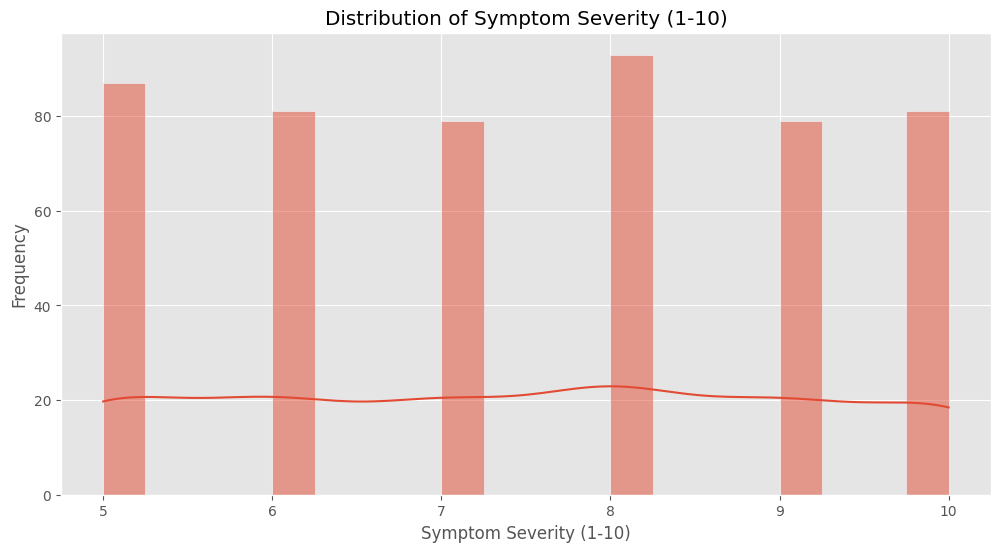


Mood Score (1-10) statistics:
count    500.000000
mean       5.482000
std        1.707486
min        3.000000
25%        4.000000
50%        5.000000
75%        7.000000
max        8.000000
Name: Mood Score (1-10), dtype: float64


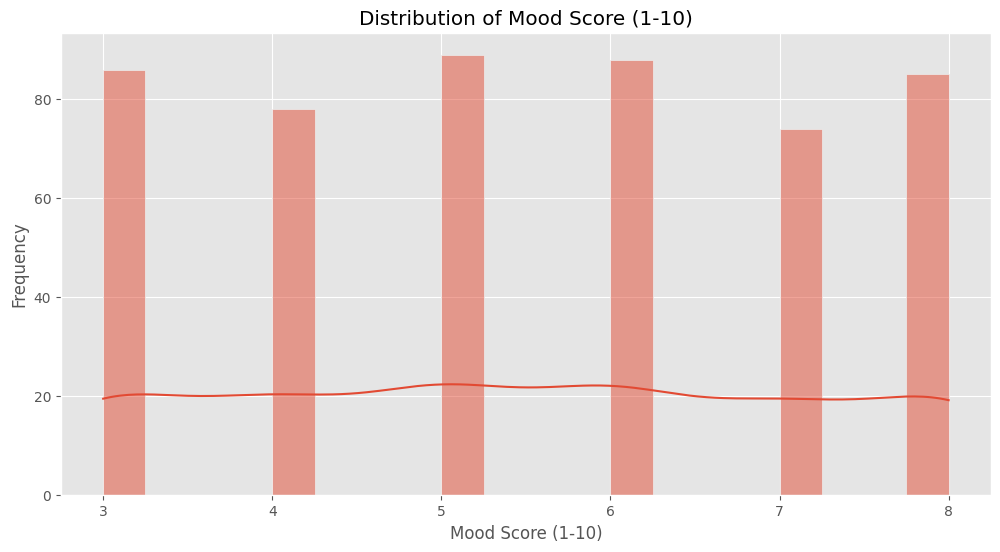


Sleep Quality (1-10) statistics:
count    500.000000
mean       6.472000
std        1.668167
min        4.000000
25%        5.000000
50%        6.000000
75%        8.000000
max        9.000000
Name: Sleep Quality (1-10), dtype: float64


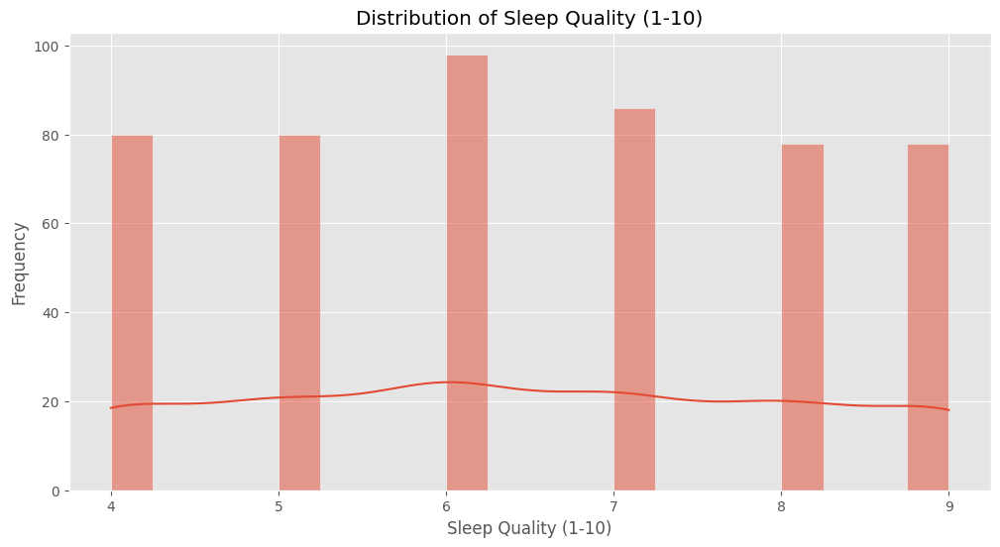


Physical Activity (hrs/week) statistics:
count    500.000000
mean       5.216000
std        2.829374
min        1.000000
25%        3.000000
50%        5.000000
75%        8.000000
max       10.000000
Name: Physical Activity (hrs/week), dtype: float64


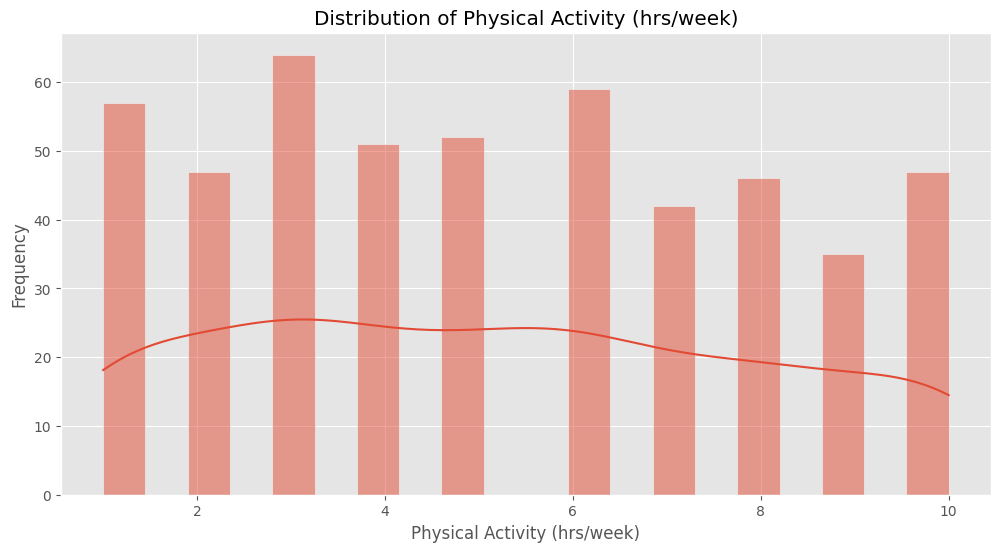


Treatment Duration (weeks) statistics:
count    500.000000
mean      12.110000
std        2.440864
min        8.000000
25%       10.000000
50%       12.000000
75%       14.000000
max       16.000000
Name: Treatment Duration (weeks), dtype: float64


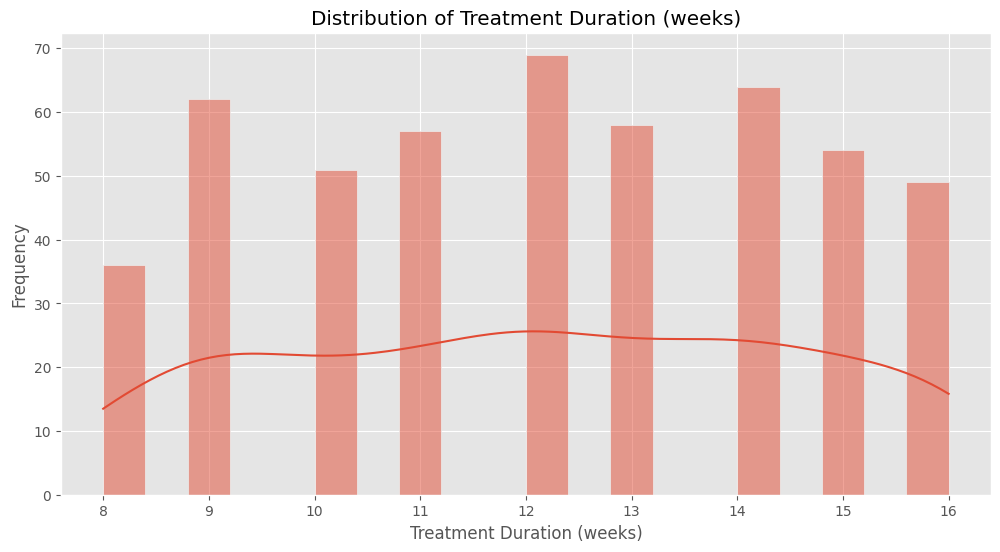


Stress Level (1-10) statistics:
count    500.000000
mean       7.542000
std        1.709409
min        5.000000
25%        6.000000
50%        8.000000
75%        9.000000
max       10.000000
Name: Stress Level (1-10), dtype: float64


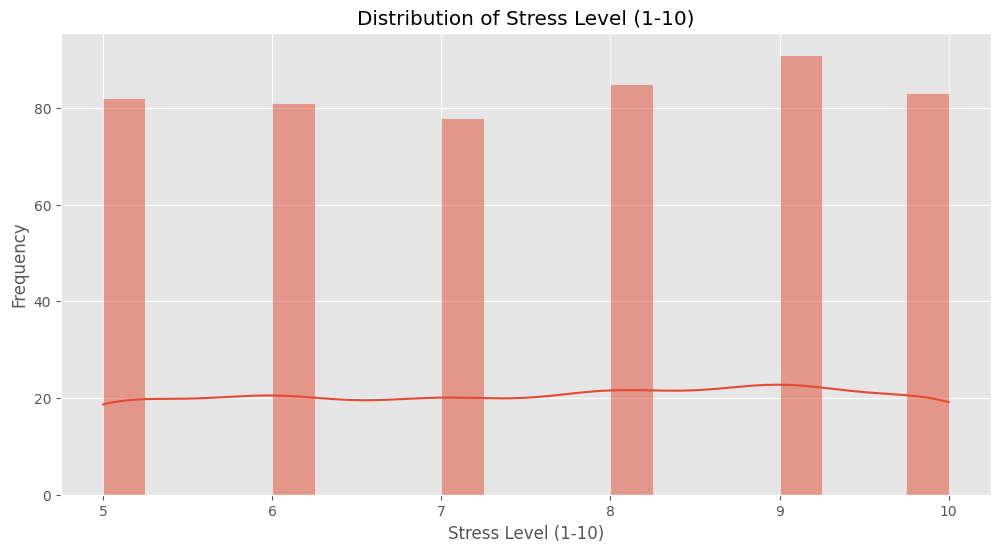


Treatment Progress (1-10) statistics:
count    500.000000
mean       7.436000
std        1.725067
min        5.000000
25%        6.000000
50%        7.000000
75%        9.000000
max       10.000000
Name: Treatment Progress (1-10), dtype: float64


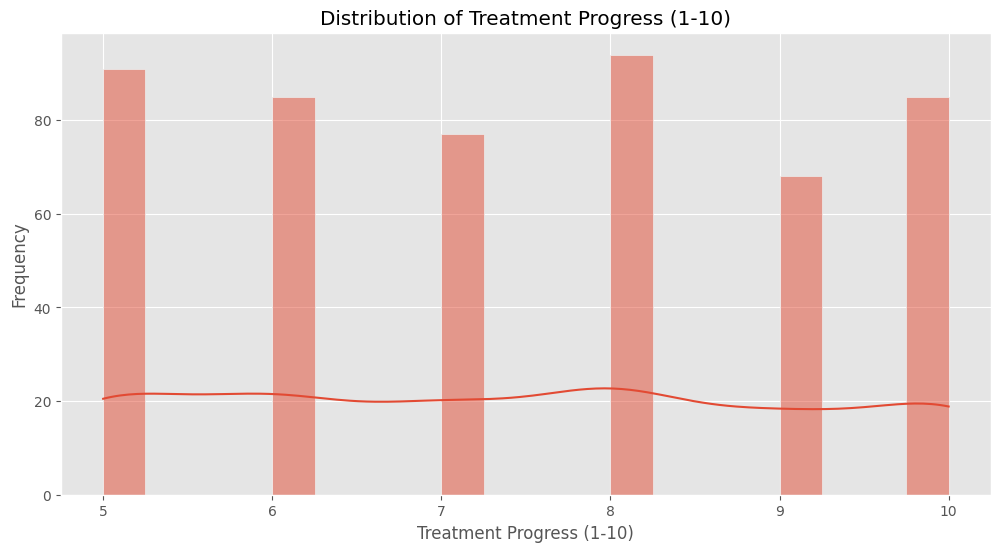


Adherence to Treatment (%) statistics:
count    500.00000
mean      75.45400
std        9.08697
min       60.00000
25%       67.00000
50%       76.00000
75%       84.00000
max       90.00000
Name: Adherence to Treatment (%), dtype: float64


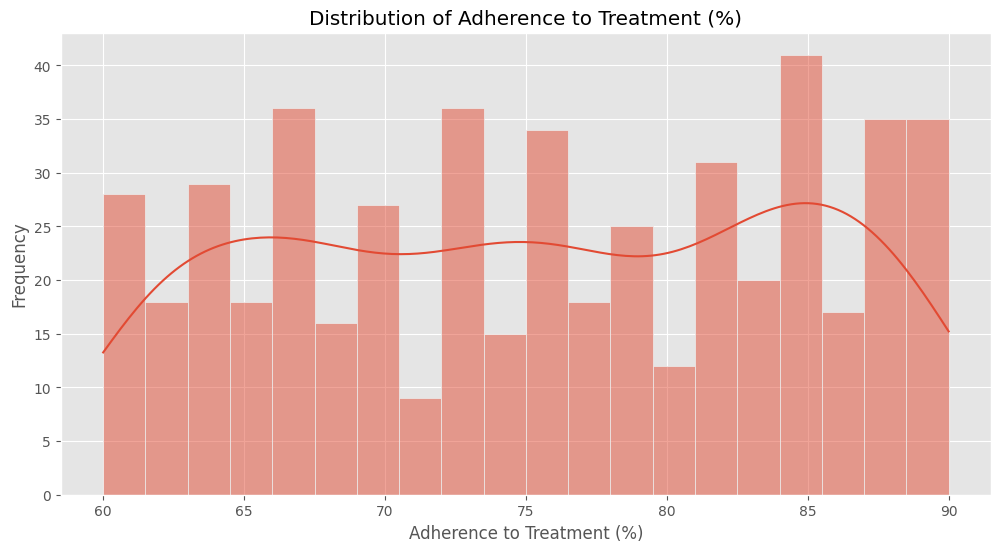

In [17]:
numerical_cols = ['Age', 'Symptom Severity (1-10)', 'Mood Score (1-10)',
                 'Sleep Quality (1-10)', 'Physical Activity (hrs/week)',
                 'Treatment Duration (weeks)', 'Stress Level (1-10)',
                 'Treatment Progress (1-10)', 'Adherence to Treatment (%)']

print("\n=== NUMERICAL FEATURE ANALYSIS ===")
for col in numerical_cols:
    if col in diagnosis_clean.columns:
        print(f"\n{col} statistics:")
        print(diagnosis_clean[col].describe())

        plt.figure(figsize=(12, 6))
        sns.histplot(diagnosis_clean[col], bins=20, kde=True)
        plt.title(f'Distribution of {col}')
        plt.xlabel(col)
        plt.ylabel('Frequency')
        plt.show()

Categorical features analysis


=== CATEGORICAL FEATURE ANALYSIS ===

Gender distribution:
Gender
Male      266
Female    234
Name: count, dtype: int64


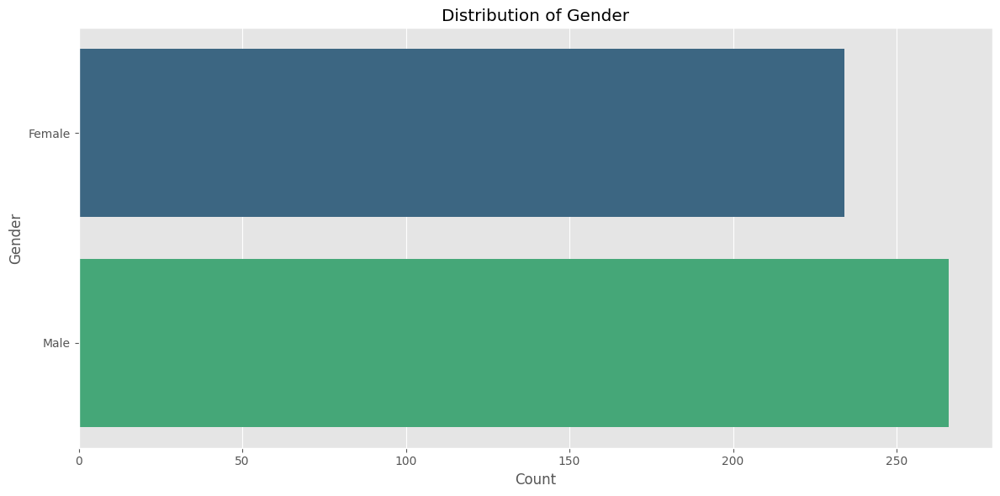


Diagnosis distribution:
Diagnosis
Generalized Anxiety          135
Major Depressive Disorder    125
Bipolar Disorder             124
Panic Disorder               116
Name: count, dtype: int64


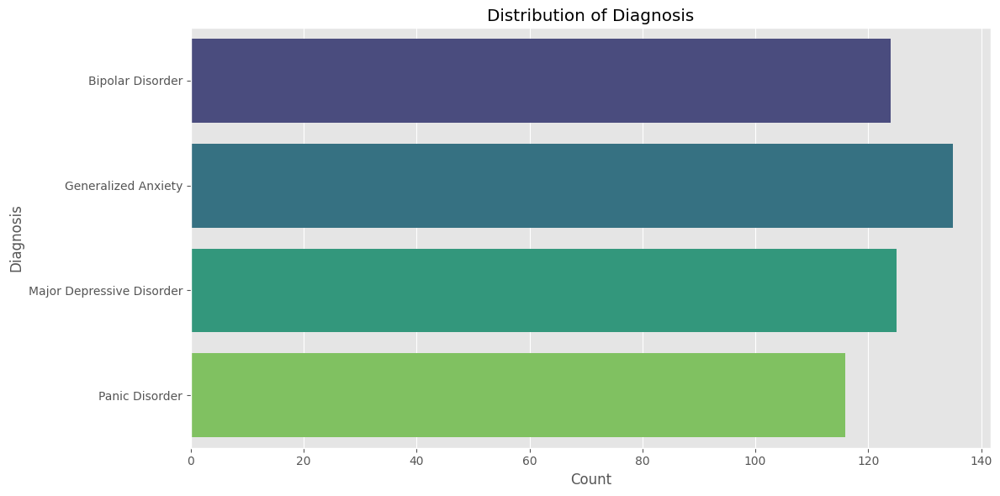


Medication distribution:
Medication
Benzodiazepines     90
SSRIs               89
Mood Stabilizers    87
Antipsychotics      87
Antidepressants     76
Anxiolytics         71
Name: count, dtype: int64


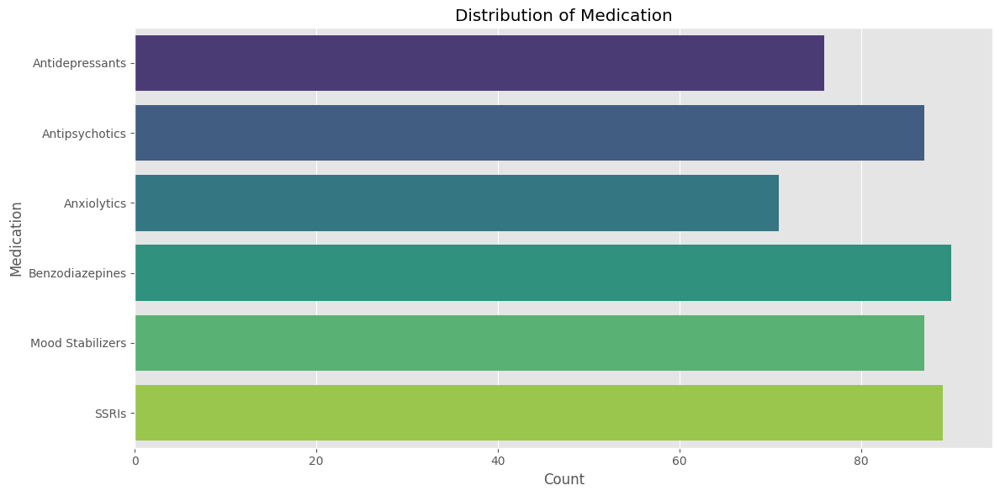


Therapy Type distribution:
Therapy Type
Mindfulness-Based Therapy         130
Dialectical Behavioral Therapy    129
Interpersonal Therapy             124
Cognitive Behavioral Therapy      117
Name: count, dtype: int64


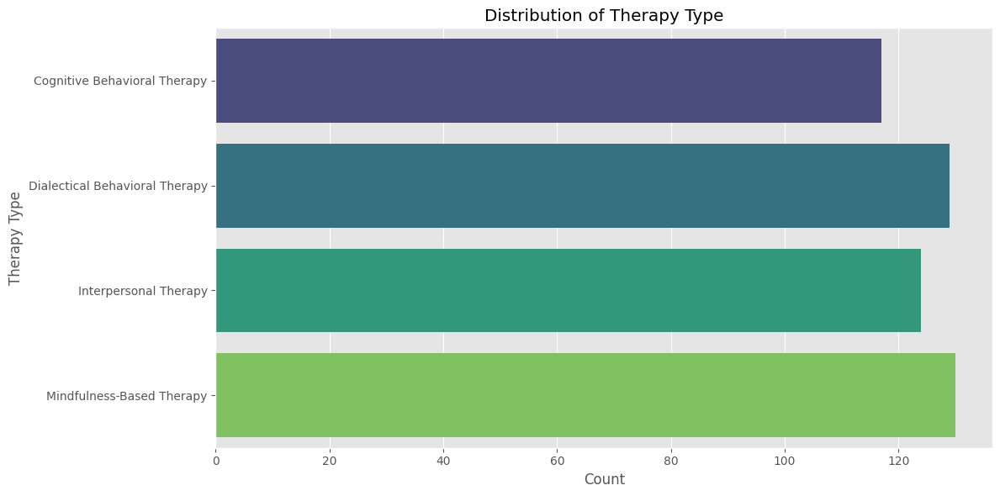


Outcome distribution:
Outcome
Deteriorated    171
Improved        170
No Change       159
Name: count, dtype: int64


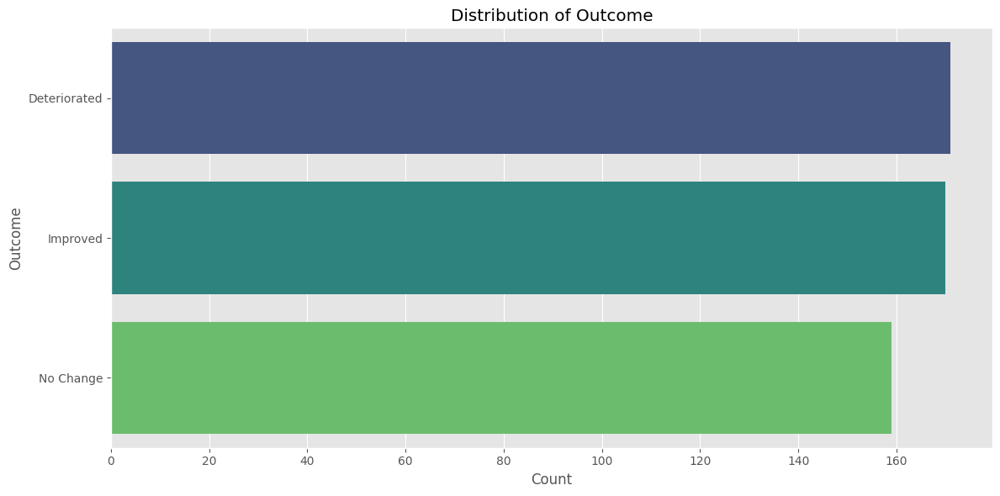


AI-Detected Emotional State distribution:
AI-Detected Emotional State
Anxious      102
Neutral       87
Excited       85
Stressed      79
Happy         78
Depressed     69
Name: count, dtype: int64


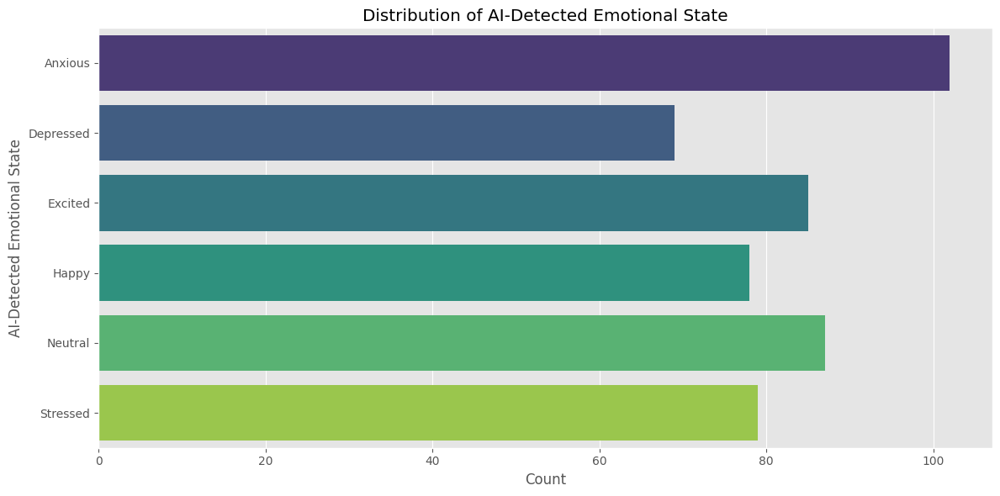

In [18]:
print("\n=== CATEGORICAL FEATURE ANALYSIS ===")
for col in categorical_cols:
    if col in diagnosis_clean.columns:
        counts = diagnosis_clean[col].value_counts()
        print(f"\n{col} distribution:")
        print(counts)

        plt.figure(figsize=(12, 6))
        if len(counts) > 20:
            counts = counts[:20]
        sns.barplot(x=counts.values, y=counts.index, palette='viridis')
        plt.title(f'Distribution of {col}')
        plt.xlabel('Count')
        plt.ylabel(col)
        plt.tight_layout()
        plt.show()

Correlation analysis


=== CORRELATION ANALYSIS ===


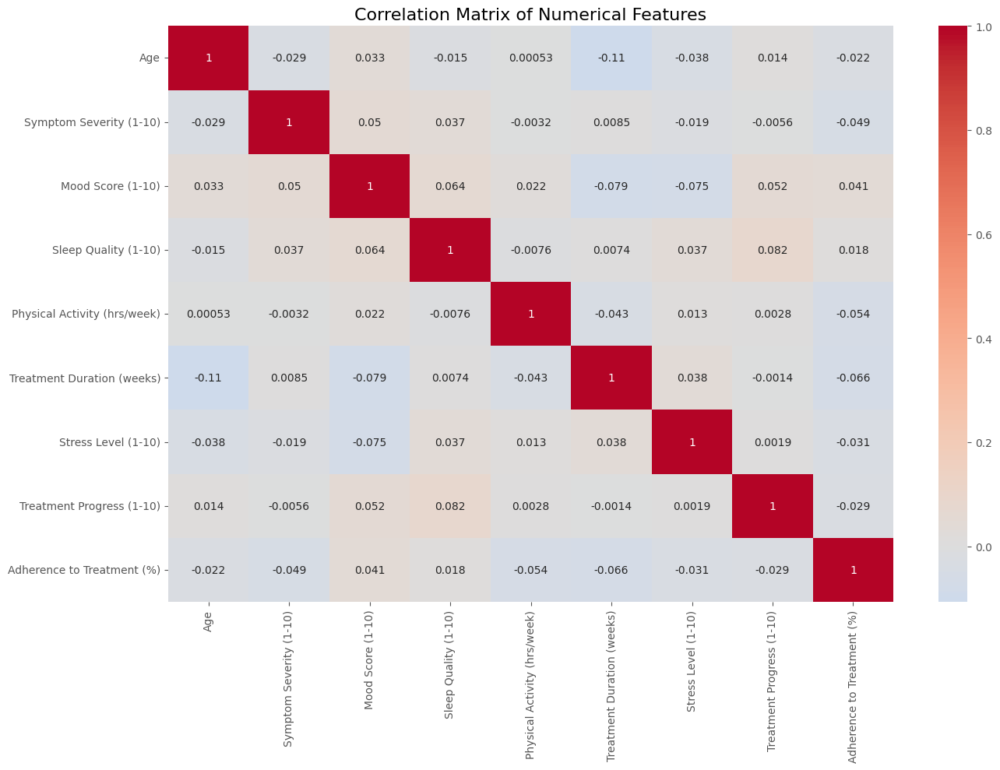

In [19]:
print("\n=== CORRELATION ANALYSIS ===")
if len(numerical_cols) > 1:
    plt.figure(figsize=(14, 10))
    corr_matrix = diagnosis_clean[numerical_cols].corr()
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', center=0)
    plt.title('Correlation Matrix of Numerical Features', fontsize=16)
    plt.tight_layout()
    plt.show()

Diagnosis-specific analysis


=== DIAGNOSIS-SPECIFIC ANALYSIS ===


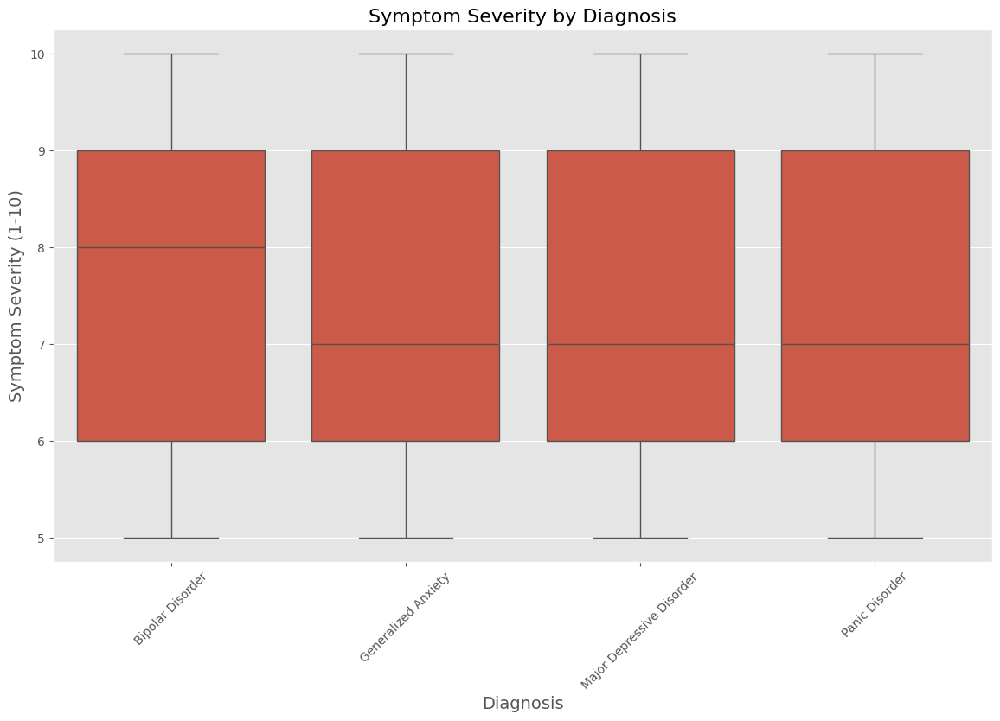

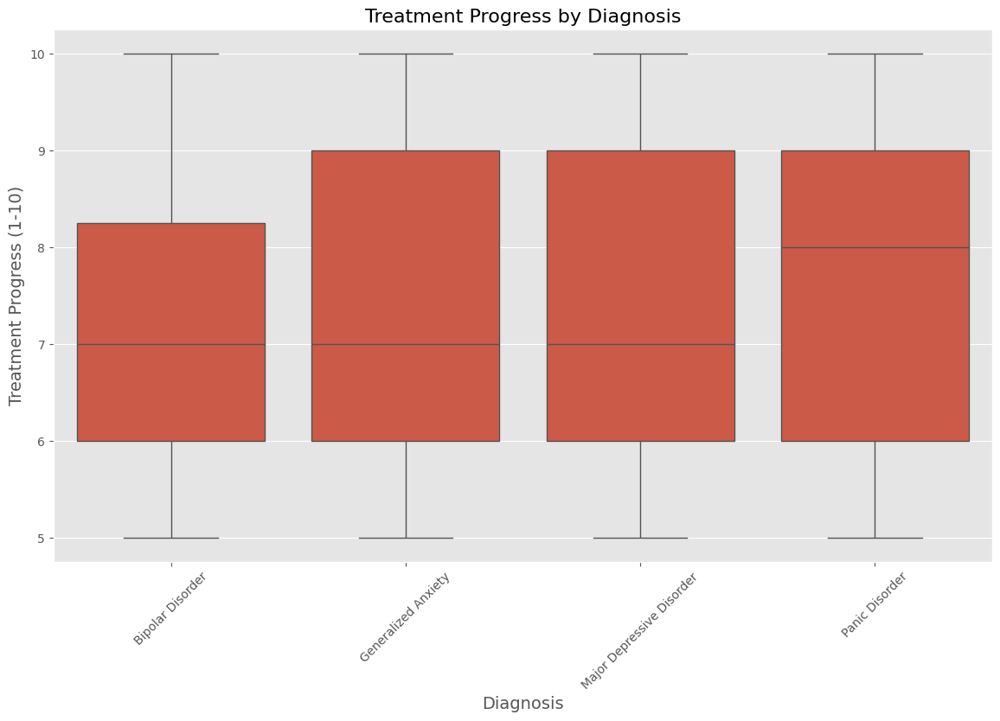


Treatment Outcomes by Diagnosis:
Outcome                    Deteriorated  Improved  No Change
Diagnosis                                                   
Bipolar Disorder                     46        44         34
Generalized Anxiety                  37        53         45
Major Depressive Disorder            44        32         49
Panic Disorder                       44        41         31


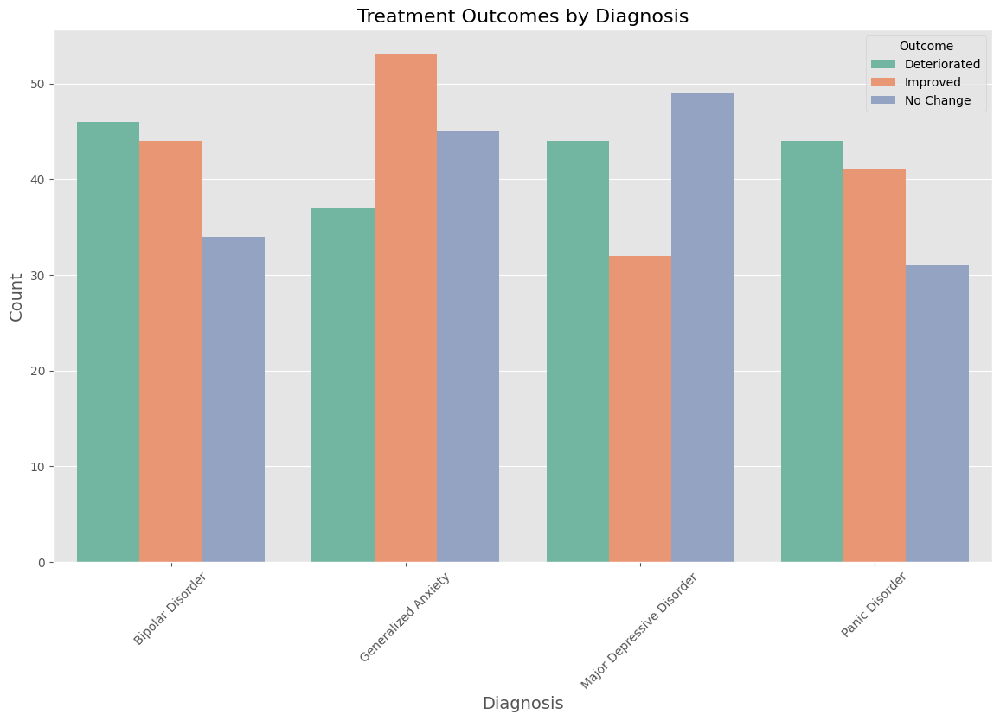


===== MENTAL HEALTH DIAGNOSIS ANALYSIS COMPLETE =====


In [20]:
if 'Diagnosis' in diagnosis_clean.columns:
    print("\n=== DIAGNOSIS-SPECIFIC ANALYSIS ===")

    # Diagnosis vs Symptom Severity
    plt.figure(figsize=(14, 8))
    sns.boxplot(x='Diagnosis', y='Symptom Severity (1-10)', data=diagnosis_clean)
    plt.title('Symptom Severity by Diagnosis', fontsize=16)
    plt.xlabel('Diagnosis', fontsize=14)
    plt.ylabel('Symptom Severity (1-10)', fontsize=14)
    plt.xticks(rotation=45)
    plt.show()

    # Diagnosis vs Treatment Progress
    plt.figure(figsize=(14, 8))
    sns.boxplot(x='Diagnosis', y='Treatment Progress (1-10)', data=diagnosis_clean)
    plt.title('Treatment Progress by Diagnosis', fontsize=16)
    plt.xlabel('Diagnosis', fontsize=14)
    plt.ylabel('Treatment Progress (1-10)', fontsize=14)
    plt.xticks(rotation=45)
    plt.show()

    # Treatment effectiveness by diagnosis
    if 'Outcome' in diagnosis_clean.columns:
        print("\nTreatment Outcomes by Diagnosis:")
        print(pd.crosstab(diagnosis_clean['Diagnosis'], diagnosis_clean['Outcome']))

        plt.figure(figsize=(14, 8))
        sns.countplot(x='Diagnosis', hue='Outcome', data=diagnosis_clean, palette='Set2')
        plt.title('Treatment Outcomes by Diagnosis', fontsize=16)
        plt.xlabel('Diagnosis', fontsize=14)
        plt.ylabel('Count', fontsize=14)
        plt.xticks(rotation=45)
        plt.legend(title='Outcome')
        plt.show()

print("\n===== MENTAL HEALTH DIAGNOSIS ANALYSIS COMPLETE =====")